In [1]:
import ipyvolume as ipv
import tyssue
import json
import matplotlib.pylab as plt
import numpy as np
import pandas as pd
import random
import sys
import logging
import tyssue.io.hdf5 as hdf5
from IPython.display import Image
from scipy import optimize
from tyssue.draw import sheet_view

from tyssue import Sheet
from tyssue import SheetGeometry

##### Own functions
import src.cellDivisionOld as cellDivisionOld
import src.cellDivision as cellDivision
import src.vertexModel as vertexModel
import src.inputMechanicalParameters as inputMechanicalParameters
import src.auxFunctions as auxFunctions
from tyssue.topology import add_vert

from tyssue.draw.plt_draw import create_gif
from tyssue.draw import highlight_faces, create_gif
from IPython.display import Image

from tyssue.topology.base_topology import add_vert, close_face, collapse_edge, remove_face
from tyssue.topology.base_topology import split_vert as base_split_vert

from matplotlib import cm
from matplotlib.cm import ScalarMappable
from mpl_toolkits.axes_grid1 import make_axes_locatable
import matplotlib.colors as mcolors

from math import sqrt
import matplotlib.pyplot as plt
from scipy.optimize import curve_fit
from scipy.stats import ttest_1samp

import json
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
from sklearn.linear_model import LinearRegression
from matplotlib.lines import Line2D





import warnings
warnings.filterwarnings("ignore")

collision solver could not be imported You may need to install CGAL and re-install tyssue


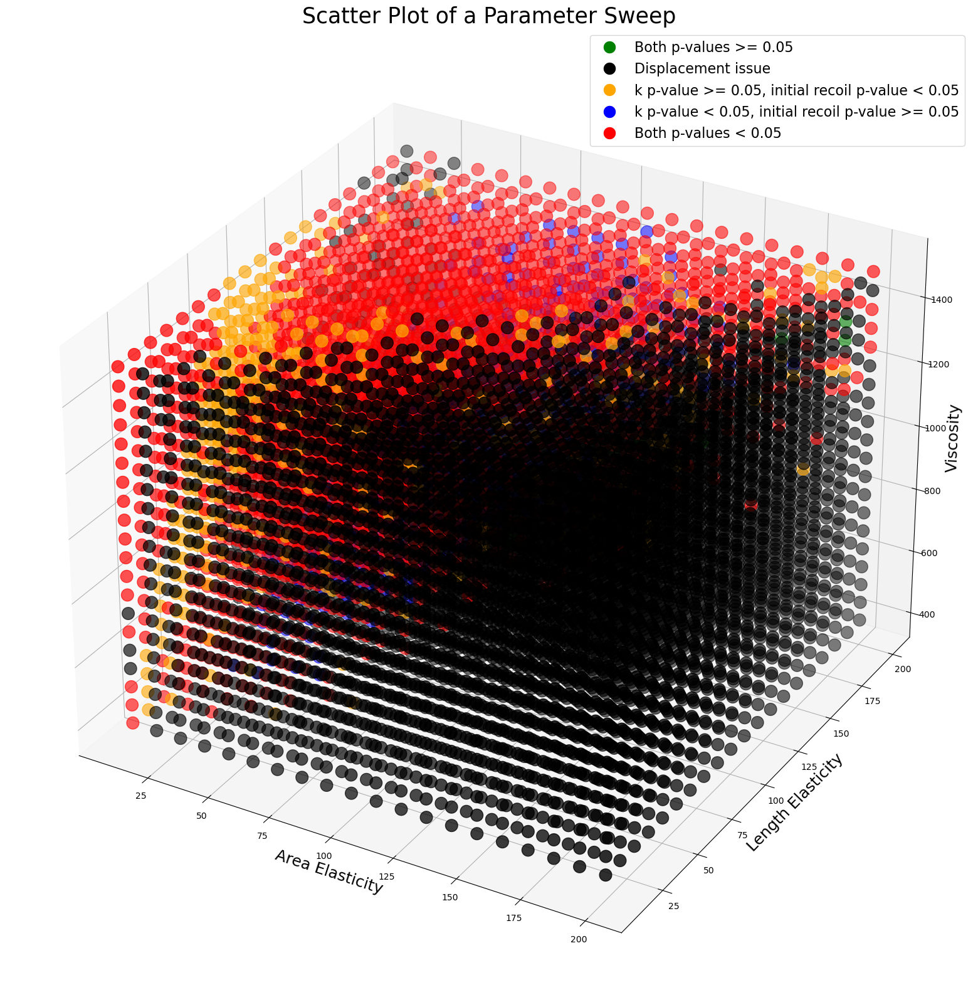

In [2]:
### plot all points from the parameter sweep 

import json
with open('LE:10-200, AE:10-200, viscosity:400-1500 , 20steps.json') as f:
    results = json.load(f)
    
    
# Function to determine the color based on the p-values and issue
def determine_color(param):
    if 'issue' in param and param['issue'] == 'Displacement issue':
        return 'black'
    k_p_value = param.get('k_p_value', None)
    initial_recoil_p_value = param.get('initial_recoil_p_value', None)
    if k_p_value is not None and initial_recoil_p_value is not None:
        if k_p_value >= 0.05 and initial_recoil_p_value >= 0.05:
            return 'green'
        elif k_p_value >= 0.05 and initial_recoil_p_value < 0.05:
            return 'orange'
        elif k_p_value < 0.05 and initial_recoil_p_value >= 0.05:
            return 'blue'
    return 'red'  # Default to red if no specific condition is met

# Function to process parameters
def process_parameters(parameters, exclude_black=False):
    area_elasticity = []
    length_elasticity = []
    viscosity = []
    colors = []
    for param in parameters:
        color = determine_color(param)
        if not exclude_black or color != 'black':  # Exclude black dots if specified
            area_elasticity.append(param["area_elasticity"]) 
            length_elasticity.append(param["length_elasticity"])
            viscosity.append(param["viscosity"])
            colors.append(color)
    return area_elasticity, length_elasticity, viscosity, colors

# Plot the first graph and capture axis limits
area_elasticity, length_elasticity, viscosity, colors = process_parameters(results['valid_parameters'] + results['invalid_parameters'])

fig = plt.figure(figsize=(20, 20))
ax = fig.add_subplot(111, projection='3d')
sc = ax.scatter(area_elasticity, length_elasticity, viscosity, c=colors, marker='o', s=200)
ax.set_xlabel('Area Elasticity', fontsize=18)
ax.set_ylabel('Length Elasticity', fontsize=18)
ax.set_zlabel('Viscosity', fontsize=18)
ax.set_title('Scatter Plot of a Parameter Sweep', fontsize=25)
ax.legend(handles=[
    Line2D([0], [0], marker='o', color='w', label='Both p-values >= 0.05', markerfacecolor='green', markersize=15),
    Line2D([0], [0], marker='o', color='w', label='Displacement issue', markerfacecolor='black', markersize=15),
    Line2D([0], [0], marker='o', color='w', label='k p-value >= 0.05, initial recoil p-value < 0.05', markerfacecolor='orange', markersize=15),
    Line2D([0], [0], marker='o', color='w', label='k p-value < 0.05, initial recoil p-value >= 0.05', markerfacecolor='blue', markersize=15),
    Line2D([0], [0], marker='o', color='w', label='Both p-values < 0.05', markerfacecolor='red', markersize=15),
], prop={'size': 16})

# Capture axis limits
xlim = ax.get_xlim()
ylim = ax.get_ylim()
zlim = ax.get_zlim()

plt.show()


In [ ]:
### plot all points but black from the parameter sweep 

# Load the results from the JSON file
file_path = 'LE:10-200, AE:10-200, viscosity:400-1500 , 20steps.json'
with open(file_path) as f:
    results = json.load(f)

# Function to determine the color based on the p-values and issue
def determine_color(param):
    if 'issue' in param and param['issue'] == 'Displacement issue':
        return 'black'
    k_p_value = param.get('k_p_value', None)
    initial_recoil_p_value = param.get('initial_recoil_p_value', None)
    if k_p_value is not None and initial_recoil_p_value is not None:
        if k_p_value >= 0.05 and initial_recoil_p_value >= 0.05:
            return 'green'
        elif k_p_value >= 0.05 and initial_recoil_p_value < 0.05:
            return 'orange'
        elif k_p_value < 0.05 and initial_recoil_p_value >= 0.05:
            return 'blue'
    return 'red'  # Default to red if no specific condition is met

# Function to process parameters
def process_parameters(parameters):
    area_elasticity = []
    length_elasticity = []
    viscosity = []
    colors = []
    for param in parameters:
        color = determine_color(param)
        if color != 'black':  # Exclude black dots
            area_elasticity.append(param["area_elasticity"]) 
            length_elasticity.append(param["length_elasticity"])
            viscosity.append(param["viscosity"])
            colors.append(color)
    return area_elasticity, length_elasticity, viscosity, colors

# Process the parameters
area_elasticity, length_elasticity, viscosity, colors = process_parameters(results['valid_parameters'] + results['invalid_parameters'])

# Create a figure and 3D axis
fig = plt.figure(figsize=(20, 20))
ax = fig.add_subplot(111, projection='3d')
sc = ax.scatter(area_elasticity, length_elasticity, viscosity, c=colors, marker='o', s=200)
ax.set_xlabel('Area Elasticity', fontsize=18)
ax.set_ylabel('Length Elasticity', fontsize=18)
ax.set_zlabel('Viscosity', fontsize=18)
ax.set_title('Scatter Plot of a Parameter Sweep', fontsize=25)
ax.legend(handles=[
    Line2D([0], [0], marker='o', color='w', label='Both p-values >= 0.05', markerfacecolor='green', markersize=15),
    Line2D([0], [0], marker='o', color='w', label='Displacement issue', markerfacecolor='black', markersize=15),
    Line2D([0], [0], marker='o', color='w', label='k p-value >= 0.05, initial recoil p-value < 0.05', markerfacecolor='orange', markersize=15),
    Line2D([0], [0], marker='o', color='w', label='k p-value < 0.05, initial recoil p-value >= 0.05', markerfacecolor='blue', markersize=15),
    Line2D([0], [0], marker='o', color='w', label='Both p-values < 0.05', markerfacecolor='red', markersize=15),
], prop={'size': 16})

# Capture axis limits
xlim = ax.get_xlim()
ylim = ax.get_ylim()
zlim = ax.get_zlim()

# Show the plot
plt.show()

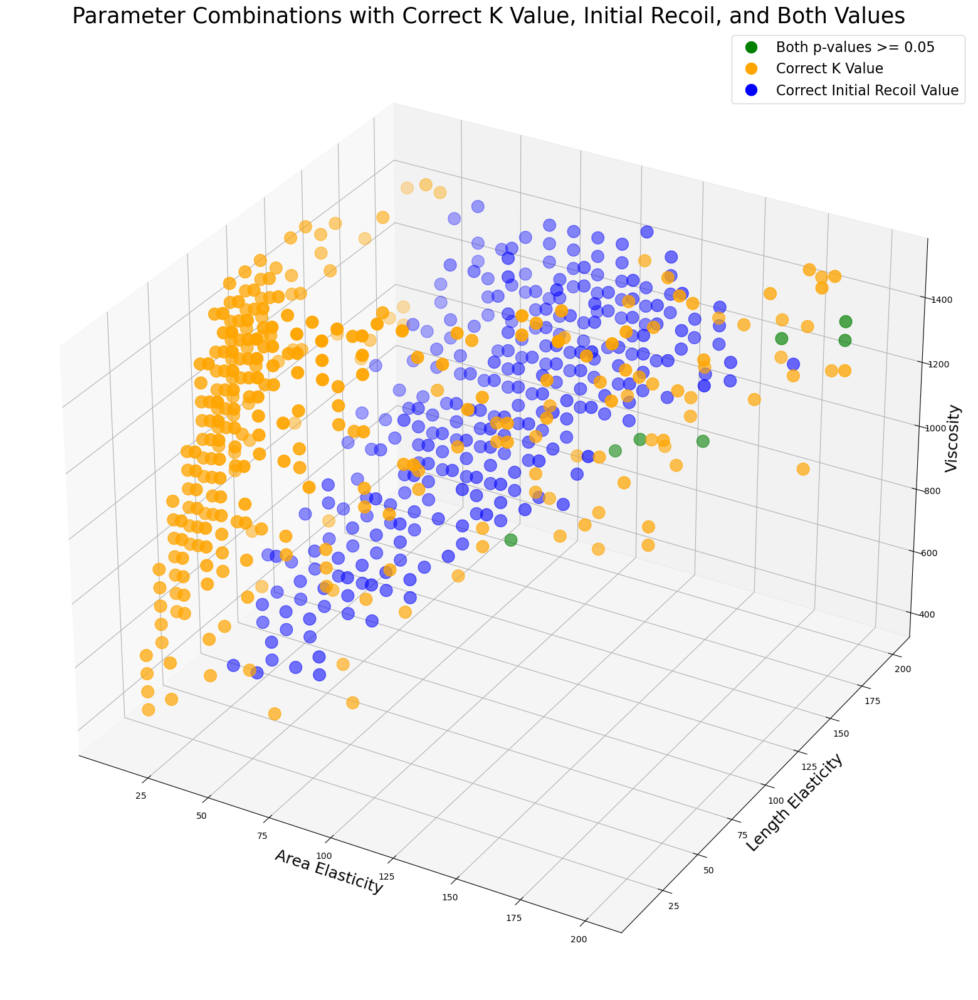

In [7]:
### plot blue, yellow and green points from the parameter sweep 


# Function to determine the color based on the p-values and issue
def determine_color(param):
    if 'issue' in param and param['issue'] == 'Displacement issue':
        return 'black'
    k_p_value = param.get('k_p_value', None)
    initial_recoil_p_value = param.get('initial_recoil_p_value', None)
    if k_p_value is not None and initial_recoil_p_value is not None:
        if k_p_value >= 0.05 and initial_recoil_p_value >= 0.05:
            return 'green'
        elif k_p_value >= 0.05 and initial_recoil_p_value < 0.05:
            return 'orange'
        elif k_p_value < 0.05 and initial_recoil_p_value >= 0.05:
            return 'blue'
    return 'red'  # Default to red if no specific condition is met

# Function to process parameters
def process_parameters(parameters):
    area_elasticity = []
    length_elasticity = []
    viscosity = []
    colors = []
    for param in parameters:
        color = determine_color(param)
        if color in ['green', 'blue', 'orange']:  # Include only green, blue, and orange dots
            area_elasticity.append(param["area_elasticity"])
            length_elasticity.append(param["length_elasticity"])
            viscosity.append(param["viscosity"])
            colors.append(color)
    return area_elasticity, length_elasticity, viscosity, colors

# Process parameters to include green, blue, and orange points
area_elasticity, length_elasticity, viscosity, colors = process_parameters(results['valid_parameters'] + results['invalid_parameters'])

# Ensure all lists have the same length
assert len(area_elasticity) == len(length_elasticity) == len(viscosity) == len(colors), "List lengths do not match"

# Create 3D scatter plot with green, blue, and orange points
fig = plt.figure(figsize=(20, 20))
ax = fig.add_subplot(111, projection='3d')
sc = ax.scatter(area_elasticity, length_elasticity, viscosity, c=colors, marker='o', s=200)

# Set labels, title, and axis limits
ax.set_xlabel('Area Elasticity', fontsize=18)
ax.set_ylabel('Length Elasticity', fontsize=18)
ax.set_zlabel('Viscosity', fontsize=18)
ax.set_title('Parameter Combinations with Correct K Value, Initial Recoil, and Both Values', fontsize=25)
ax.set_xlim(xlim)
ax.set_ylim(ylim)
ax.set_zlim(zlim)

# Create custom legend
legend_elements = [
    Line2D([0], [0], marker='o', color='w', label='Both p-values >= 0.05', markerfacecolor='green', markersize=15),
    Line2D([0], [0], marker='o', color='w', label='Correct K Value', markerfacecolor='orange', markersize=15),
    Line2D([0], [0], marker='o', color='w', label='Correct Initial Recoil Value', markerfacecolor='blue', markersize=15),
]
ax.legend(handles=legend_elements, prop={'size': 16})

plt.show()


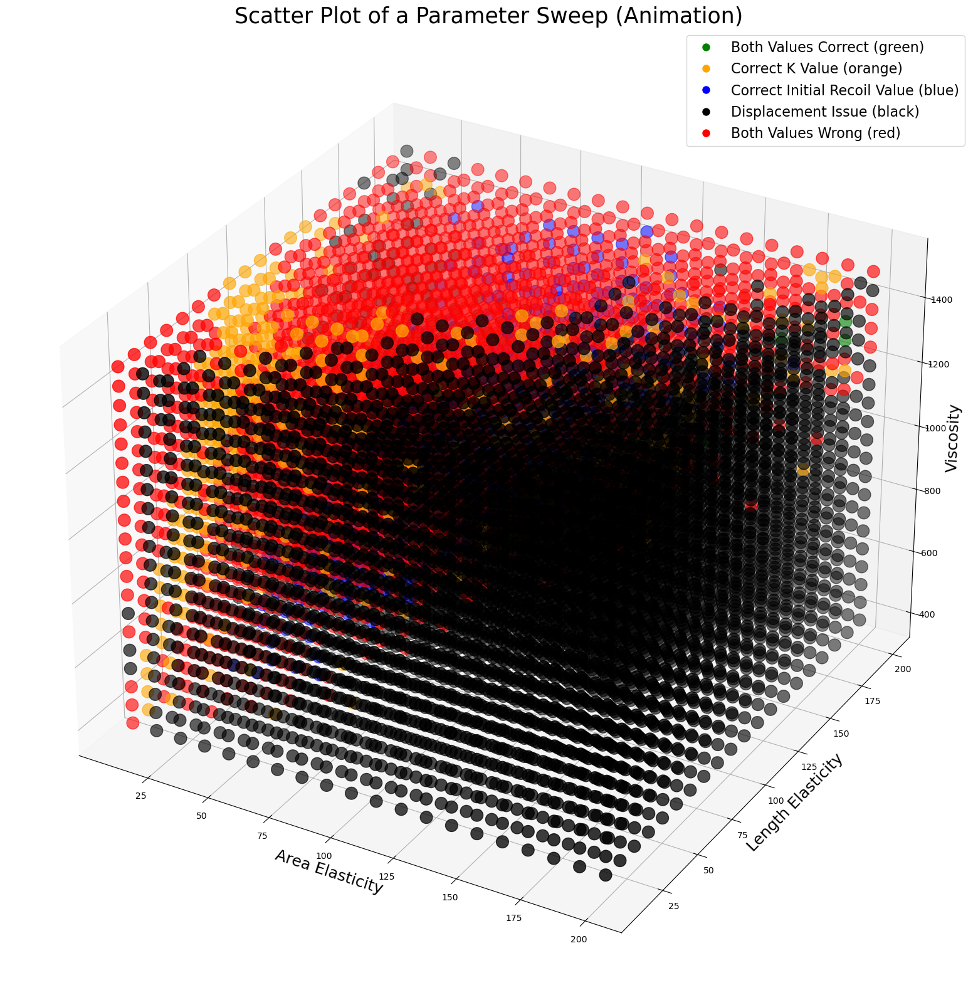

In [9]:
import matplotlib.pyplot as plt
from matplotlib import animation
from matplotlib.lines import Line2D
import numpy as np
import json

# Load the results from the JSON file
file_path = 'LE:10-200, AE:10-200, viscosity:400-1500 , 20steps.json'
with open(file_path) as f:
    results = json.load(f)

# Function to determine the color based on the p-values and issue
def determine_color(param):
    if 'issue' in param and param['issue'] == 'Displacement issue':
        return 'black'
    k_p_value = param.get('k_p_value', None)
    initial_recoil_p_value = param.get('initial_recoil_p_value', None)
    if k_p_value is not None and initial_recoil_p_value is not None:
        if k_p_value >= 0.05 and initial_recoil_p_value >= 0.05:
            return 'green'
        elif k_p_value >= 0.05 and initial_recoil_p_value < 0.05:
            return 'orange'
        elif k_p_value < 0.05 and initial_recoil_p_value >= 0.05:
            return 'blue'
    return 'red'  # Default to red if no specific condition is met

# Function to process parameters
def process_parameters(parameters):
    area_elasticity = []
    length_elasticity = []
    viscosity = []
    colors = []
    for param in parameters:
        area_elasticity.append(param["area_elasticity"])
        length_elasticity.append(param["length_elasticity"])
        viscosity.append(param["viscosity"])
        colors.append(determine_color(param))
    return area_elasticity, length_elasticity, viscosity, colors

# Process the parameters
area_elasticity, length_elasticity, viscosity, colors = process_parameters(results['valid_parameters'] + results['invalid_parameters'])

# Create a figure and 3D axis
fig = plt.figure(figsize=(20, 20))
ax = fig.add_subplot(111, projection='3d')

# Scatter plot with all points
sc = ax.scatter(area_elasticity, length_elasticity, viscosity, c=colors, marker='o', s=200)
ax.set_xlabel('Area Elasticity', fontsize=18)
ax.set_ylabel('Length Elasticity', fontsize=18)
ax.set_zlabel('Viscosity', fontsize=18)
ax.set_title('Scatter Plot of a Parameter Sweep (Animation)', fontsize=25)

# Add a legend
legend_elements = [
    Line2D([0], [0], marker='o', color='w', label='Both Values Correct (green)', markerfacecolor='green', markersize=10),
    Line2D([0], [0], marker='o', color='w', label='Correct K Value (orange)', markerfacecolor='orange', markersize=10),
    Line2D([0], [0], marker='o', color='w', label='Correct Initial Recoil Value (blue)', markerfacecolor='blue', markersize=10),
    Line2D([0], [0], marker='o', color='w', label='Displacement Issue (black)', markerfacecolor='black', markersize=10),
    Line2D([0], [0], marker='o', color='w', label='Both Values Wrong (red)', markerfacecolor='red', markersize=10)
]
ax.legend(handles=legend_elements, prop={'size': 16})

# Capture axis limits
xlim = ax.get_xlim()
ylim = ax.get_ylim()
zlim = ax.get_zlim()

# Create masks for different colors
mask_black = [c == 'black' for c in colors]
mask_red = [c == 'red' for c in colors]
mask_orange = [c == 'orange' for c in colors]
mask_blue = [c == 'blue' for c in colors]
mask_green = [c == 'green' for c in colors]

# Create the animation
def update(num, sc, ax):
    ax.view_init(elev=10., azim=num)
    
    if num < 120:
        # All points (Initial)
        mask = np.ones(len(colors), dtype=bool)
    elif num < 240:
        # Remove black points
        mask = ~np.array(mask_black)
    elif num < 360:
        # Remove red points
        mask = ~np.array(mask_black) & ~np.array(mask_red)
    elif num < 480:
        # Show only orange points
        mask = np.array(mask_orange)
    elif num < 600:
        # Show orange and blue points
        mask = np.array(mask_orange) | np.array(mask_blue)
    elif num < 720:
        # Remove orange points
        mask = np.array(mask_blue)
    elif num < 800:
        # Show blue and green points
        mask = np.array(mask_blue) | np.array(mask_green)
    else:
        # Show only green points
        mask = np.array(mask_green)

    sc._offsets3d = (np.array(area_elasticity)[mask], np.array(length_elasticity)[mask], np.array(viscosity)[mask])
    sc.set_color(np.array(colors)[mask])

    return sc,

# Show the plot
plt.show()


In [ ]:
import matplotlib.pyplot as plt
from matplotlib import animation
from matplotlib.lines import Line2D
import numpy as np
import json
from sklearn.linear_model import LinearRegression

# Load the results from the JSON file
file_path = 'LE:10-200, AE:10-200, viscosity:400-1500 , 20steps.json'
with open(file_path) as f:
    results = json.load(f)

# Function to determine the color based on the p-values and issue
def determine_color(param):
    if 'issue' in param and param['issue'] == 'Displacement issue':
        return 'black'
    k_p_value = param.get('k_p_value', None)
    initial_recoil_p_value = param.get('initial_recoil_p_value', None)
    if k_p_value is not None and initial_recoil_p_value is not None:
        if k_p_value >= 0.05 and initial_recoil_p_value >= 0.05:
            return 'green'
        elif k_p_value >= 0.05 and initial_recoil_p_value < 0.05:
            return 'orange'
        elif k_p_value < 0.05 and initial_recoil_p_value >= 0.05:
            return 'blue'
    return 'red'  # Default to red if no specific condition is met

# Function to process parameters
def process_parameters(parameters):
    area_elasticity = []
    length_elasticity = []
    viscosity = []
    colors = []
    for param in parameters:
        area_elasticity.append(param["area_elasticity"])
        length_elasticity.append(param["length_elasticity"])
        viscosity.append(param["viscosity"])
        colors.append(determine_color(param))
    return area_elasticity, length_elasticity, viscosity, colors

# Process the parameters
area_elasticity, length_elasticity, viscosity, colors = process_parameters(results['valid_parameters'] + results['invalid_parameters'])

# Identify green points for the best fit line calculation
def is_green(param):
    if 'issue' in param and param['issue'] == 'Displacement issue':
        return False
    k_p_value = param.get('k_p_value', None)
    initial_recoil_p_value = param.get('initial_recoil_p_value', None)
    return k_p_value is not None and initial_recoil_p_value is not None and k_p_value >= 0.05 and initial_recoil_p_value >= 0.05

# Filter green points
green_area_elasticity, green_length_elasticity, green_viscosity, _ = process_parameters([p for p in results['valid_parameters'] + results['invalid_parameters'] if is_green(p)])

# Prepare the data for fitting
X = np.array(list(zip(green_area_elasticity, green_length_elasticity)))
y = np.array(green_viscosity)

# Fit the linear regression model
model = LinearRegression().fit(X, y)
predicted_viscosity = model.predict(X)

# Extract the coefficients and intercept
coef = model.coef_
intercept = model.intercept_

# Generate points along the best fit line
line_area_elasticity = np.linspace(min(green_area_elasticity), max(green_area_elasticity), 100)
line_length_elasticity = np.linspace(min(green_length_elasticity), max(green_length_elasticity), 100)
line_viscosity = coef[0] * line_area_elasticity + coef[1] * line_length_elasticity + intercept

# Create a figure and 3D axis
fig = plt.figure(figsize=(20, 20))
ax = fig.add_subplot(111, projection='3d')

# Scatter plot with all points
sc = ax.scatter(area_elasticity, length_elasticity, viscosity, c=colors, marker='o', s=200)
line, = ax.plot(line_area_elasticity, line_length_elasticity, line_viscosity, color='r', linewidth=2, label='Best Fit Line', visible=False)
ax.set_xlabel('Area Elasticity', fontsize=18)
ax.set_ylabel('Length Elasticity', fontsize=18)
ax.set_zlabel('Viscosity', fontsize=18)
ax.set_title('Scatter Plot of a Parameter Sweep (Animation)', fontsize=25)

# Add a legend
legend_elements = [
    Line2D([0], [0], marker='o', color='w', label='Both Values Correct (green)', markerfacecolor='green', markersize=10),
    Line2D([0], [0], marker='o', color='w', label='Correct K Value (orange)', markerfacecolor='orange', markersize=10),
    Line2D([0], [0], marker='o', color='w', label='Correct Initial Recoil Value (blue)', markerfacecolor='blue', markersize=10),
    Line2D([0], [0], marker='o', color='w', label='Displacement Issue (black)', markerfacecolor='black', markersize=10),
    Line2D([0], [0], marker='o', color='w', label='Both Values Wrong (red)', markerfacecolor='red', markersize=10),
    Line2D([0], [0], color='r', lw=2, label='Best Fit Line')
]
ax.legend(handles=legend_elements, prop={'size': 16})

# Capture axis limits
xlim = ax.get_xlim()
ylim = ax.get_ylim()
zlim = ax.get_zlim()

# Create masks for different colors
mask_black = [c == 'black' for c in colors]
mask_red = [c == 'red' for c in colors]
mask_orange = [c == 'orange' for c in colors]
mask_blue = [c == 'blue' for c in colors]
mask_green = [c == 'green' for c in colors]

# Create the animation
def update(num, sc, ax, line):
    ax.view_init(elev=10., azim=num)
    
    if num < 120:
        # All points (Initial)
        mask = np.ones(len(colors), dtype=bool)
    elif num < 240:
        # Remove black points
        mask = ~np.array(mask_black)
    elif num < 360:
        # Remove red points
        mask = ~np.array(mask_black) & ~np.array(mask_red)
    elif num < 480:
        # Show only orange points
        mask = np.array(mask_orange)
    elif num < 600:
        # Show orange and blue points
        mask = np.array(mask_orange) | np.array(mask_blue)
    elif num < 720:
        # Remove orange points
        mask = np.array(mask_blue)
    elif num < 840:
        # Show blue and green points
        mask = np.array(mask_blue) | np.array(mask_green)
    elif num < 960:
        # Show only green points
        mask = np.array(mask_green)
    elif num < 1000:
        # Rotate green points only
        mask = np.array(mask_green)
    elif num < 1200:
        # Show green points and best fit line
        mask = np.array(mask_green)
        line.set_visible(True)

    sc._offsets3d = (np.array(area_elasticity)[mask], np.array(length_elasticity)[mask], np.array(viscosity)[mask])
    sc.set_color(np.array(colors)[mask])

    return sc, line

ani = animation.FuncAnimation(fig, update, frames=np.arange(0, 1200, 1), fargs=(sc, ax, line), interval=50)

# Save the animation as a video
ani.save('zoom_animation_transitions_with_best_fit_line.mp4', writer='ffmpeg', fps=30)

# Show the plot
plt.show()


In [ ]:
import matplotlib.pyplot as plt
from matplotlib import animation
from matplotlib.lines import Line2D
import numpy as np
import json

# Load the results from the JSON file
file_path = 'LE:10-200, AE:10-200, viscosity:300-1000 , 20steps.json'
with open(file_path) as f:
    results = json.load(f)

# Function to determine the color based on the p-values and issue
def determine_color(param):
    if 'issue' in param and param['issue'] == 'Displacement issue':
        return 'black'
    k_p_value = param.get('k_p_value', None)
    initial_recoil_p_value = param.get('initial_recoil_p_value', None)
    if k_p_value is not None and initial_recoil_p_value is not None:
        if k_p_value >= 0.05 and initial_recoil_p_value >= 0.05:
            return 'green'
        elif k_p_value >= 0.05 and initial_recoil_p_value < 0.05:
            return 'orange'
        elif k_p_value < 0.05 and initial_recoil_p_value >= 0.05:
            return 'blue'
    return 'red'  # Default to red if no specific condition is met

# Function to process parameters
def process_parameters(parameters):
    area_elasticity = []
    length_elasticity = []
    viscosity = []
    colors = []
    for param in parameters:
        area_elasticity.append(param["area_elasticity"])
        length_elasticity.append(param["length_elasticity"])
        viscosity.append(param["viscosity"])
        colors.append(determine_color(param))
    return area_elasticity, length_elasticity, viscosity, colors

# Process the parameters
area_elasticity, length_elasticity, viscosity, colors = process_parameters(results['valid_parameters'] + results['invalid_parameters'])

# Create a figure and 3D axis
fig = plt.figure(figsize=(20, 20))
ax = fig.add_subplot(111, projection='3d')

# Scatter plot with all points
sc = ax.scatter(area_elasticity, length_elasticity, viscosity, c=colors, marker='o', s=200)
ax.set_xlabel('Area Elasticity', fontsize=18)
ax.set_ylabel('Length Elasticity', fontsize=18)
ax.set_zlabel('Viscosity', fontsize=18)
ax.set_title('Scatter Plot of a Parameter Sweep (Animation)', fontsize=25)

# Capture axis limits
xlim = ax.get_xlim()
ylim = ax.get_ylim()
zlim = ax.get_zlim()

# Create masks for different colors
mask_black = [c == 'black' for c in colors]
mask_red = [c == 'red' for c in colors]
mask_orange = [c == 'orange' for c in colors]
mask_blue = [c == 'blue' for c in colors]
mask_green = [c == 'green' for c in colors]

# Create the animation
def update(num, sc, ax):
    ax.view_init(elev=10., azim=num)
    
    if num < 120:
        # All points (Initial)
        mask = np.ones(len(colors), dtype=bool)
    elif num < 240:
        # Remove black points
        mask = ~np.array(mask_black)
    elif num < 360:
        # Remove red points
        mask = ~np.array(mask_black) & ~np.array(mask_red)
    elif num < 480:
        # Show only orange points
        mask = np.array(mask_orange)
    elif num < 600:
        # Show orange and blue points
        mask = np.array(mask_orange) | np.array(mask_blue)
    elif num < 720:
        # Remove orange points
        mask = np.array(mask_blue)
    elif num < 840:
        # Show blue and green points
        mask = np.array(mask_blue) | np.array(mask_green)
    else:
        # Show only green points
        mask = np.array(mask_green)

    sc._offsets3d = (np.array(area_elasticity)[mask], np.array(length_elasticity)[mask], np.array(viscosity)[mask])
    sc.set_color(np.array(colors)[mask])

    return sc,

ani = animation.FuncAnimation(fig, update, frames=np.arange(0, 960, 1), fargs=(sc, ax), interval=50)

# Save the animation as a video
ani.save('zoom_animation_transitions.mp4', writer='ffmpeg', fps=30)

# Show the plot
plt.show()


In [11]:
# Plot the second graph with same axis limits
area_elasticity, length_elasticity, viscosity, colors = process_parameters(results['valid_parameters'] + results['invalid_parameters'], exclude_black=True)

fig = plt.figure(figsize=(20, 20))
ax = fig.add_subplot(111, projection='3d')
sc = ax.scatter(area_elasticity, length_elasticity, viscosity, c=colors, marker='o', s=100)
ax.set_xlabel('Area Elasticity', fontsize=18)
ax.set_ylabel('Length Elasticity', fontsize=18)
ax.set_zlabel('Viscosity', fontsize=18)
ax.set_title('Scatter Plot of a Parameter Sweep', fontsize=25)
ax.set_xlim(xlim)
ax.set_ylim(ylim)
ax.set_zlim(zlim)
ax.legend(handles=[
    Line2D([0], [0], marker='o', color='w', label='Both p-values >= 0.05', markerfacecolor='green', markersize=10),
    Line2D([0], [0], marker='o', color='w', label='k p-value >= 0.05, initial recoil p-value < 0.05', markerfacecolor='orange', markersize=10),
    Line2D([0], [0], marker='o', color='w', label='k p-value < 0.05, initial recoil p-value >= 0.05', markerfacecolor='blue', markersize=10),
    Line2D([0], [0], marker='o', color='w', label='Both p-values < 0.05', markerfacecolor='red', markersize=10),
], prop={'size': 16})

plt.show()

TypeError: process_parameters() got an unexpected keyword argument 'exclude_black'

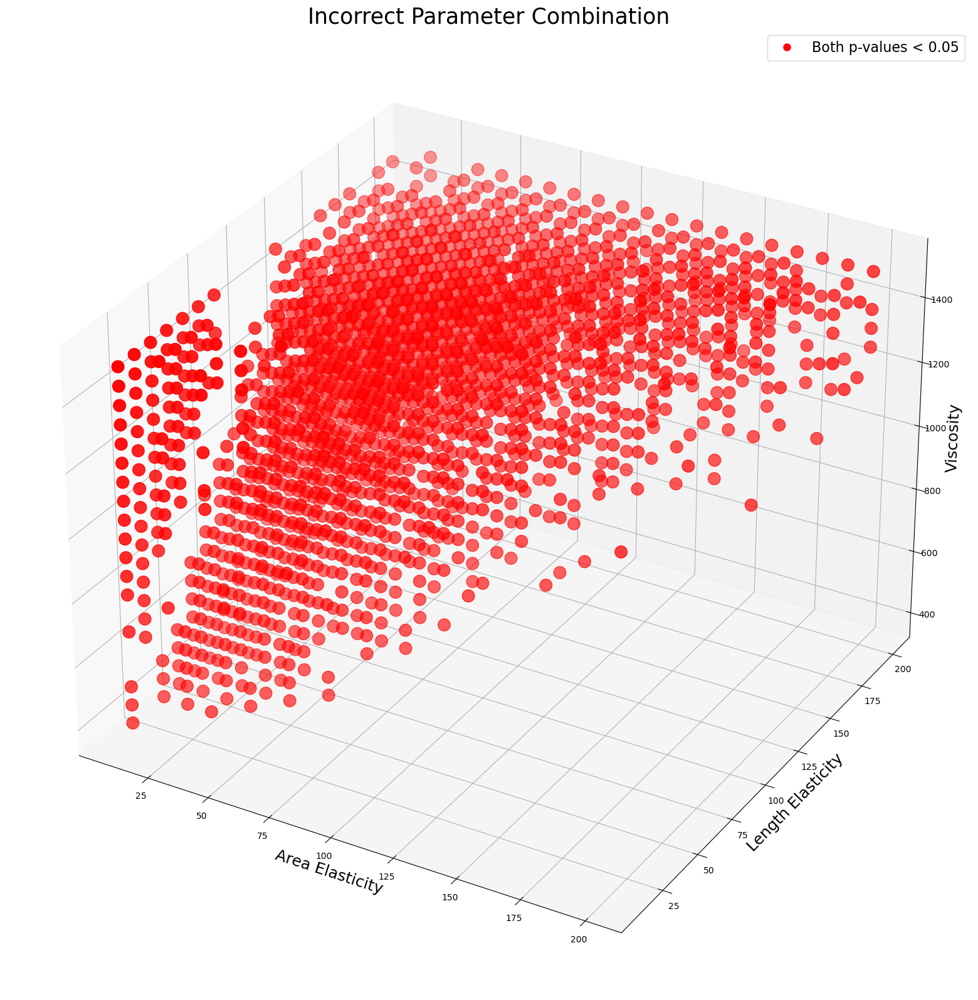

In [12]:
# Function to determine if the point should be red
def is_red(param):
    if 'issue' in param and param['issue'] == 'Displacement issue':
        return False
    k_p_value = param.get('k_p_value', None)
    initial_recoil_p_value = param.get('initial_recoil_p_value', None)
    return k_p_value is not None and initial_recoil_p_value is not None and k_p_value < 0.05 and initial_recoil_p_value < 0.05

# Function to process parameters and ensure only red points
def process_parameters_red(parameters):
    area_elasticity = []
    length_elasticity = []
    viscosity = []
    colors = []
    for param in parameters:
        if is_red(param):  # Only include red dots
            area_elasticity.append(param["area_elasticity"])
            length_elasticity.append(param["length_elasticity"])
            viscosity.append(param["viscosity"])
            colors.append('red')
    return area_elasticity, length_elasticity, viscosity, colors

# Process parameters to include only red points
red_area_elasticity, red_length_elasticity, red_viscosity, red_colors = process_parameters_red(results['valid_parameters'] + results['invalid_parameters'])

# Ensure all lists have the same length
assert len(red_area_elasticity) == len(red_length_elasticity) == len(red_viscosity) == len(red_colors), "List lengths do not match"

# Create 3D scatter plot with only red points
fig = plt.figure(figsize=(20, 20))
ax = fig.add_subplot(111, projection='3d')
sc = ax.scatter(red_area_elasticity, red_length_elasticity, red_viscosity, c=red_colors, marker='o', s=200)

# Set labels, title, and axis limits
ax.set_xlabel('Area Elasticity', fontsize=18)
ax.set_ylabel('Length Elasticity', fontsize=18)
ax.set_zlabel('Viscosity', fontsize=18)
ax.set_title('Incorrect Parameter Combination', fontsize=25)
ax.set_xlim(xlim)
ax.set_ylim(ylim)
ax.set_zlim(zlim)

# Create custom legend
legend_elements = [
    Line2D([0], [0], marker='o', color='w', label='Both p-values < 0.05', markerfacecolor='red', markersize=10),
]
ax.legend(handles=legend_elements, prop={'size': 16})

plt.show()


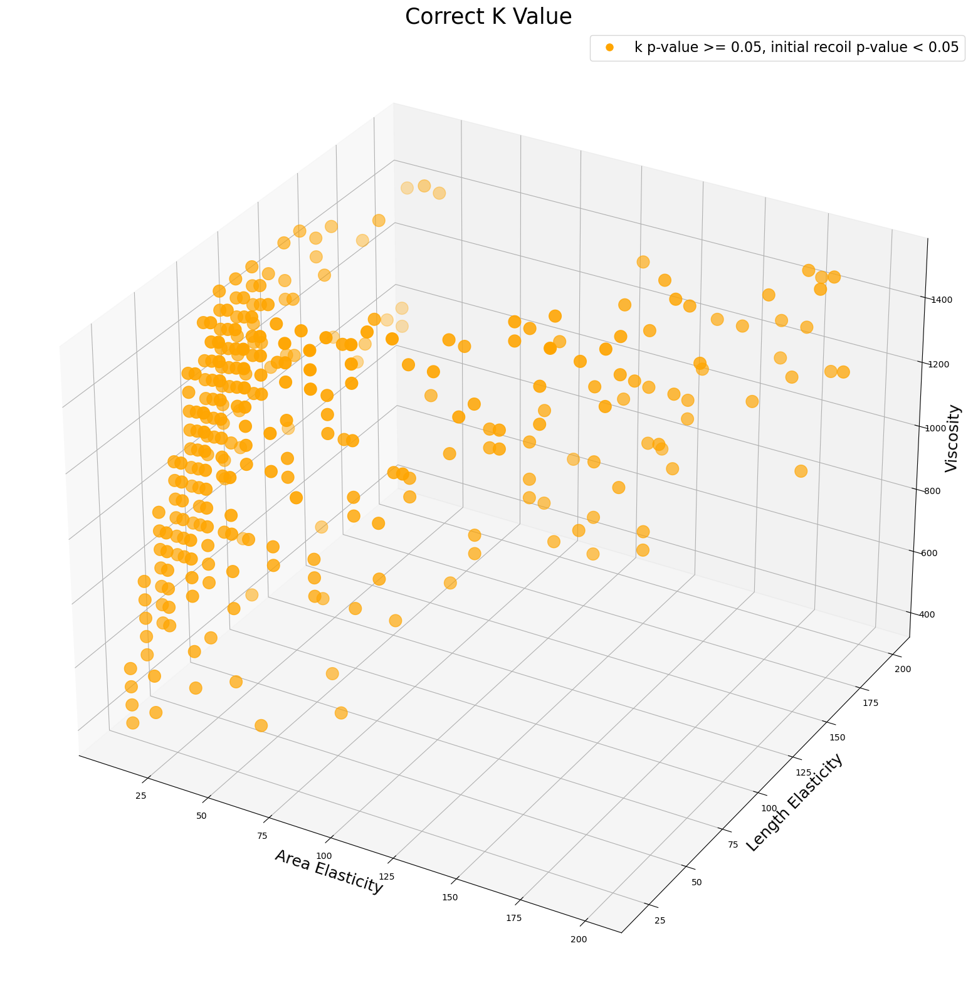

In [13]:
# Initialize lists to store data points
area_elasticity = []
length_elasticity = []
viscosity = []
colors = []

# Function to determine if the point should be yellow
def is_yellow(param):
    if 'issue' in param and param['issue'] == 'Displacement issue':
        return False
    k_p_value = param.get('k_p_value', None)
    initial_recoil_p_value = param.get('initial_recoil_p_value', None)
    return k_p_value is not None and initial_recoil_p_value is not None and k_p_value >= 0.05 and initial_recoil_p_value < 0.05

# Function to process parameters and ensure only yellow points
def process_parameters(parameters):
    for param in parameters:
        if is_yellow(param):  # Only include yellow dots
            area_elasticity.append(param["area_elasticity"])
            length_elasticity.append(param["length_elasticity"])
            viscosity.append(param["viscosity"])
            colors.append('orange')

# Process all parameters
process_parameters(results['valid_parameters'])
process_parameters(results['invalid_parameters'])

# Ensure all lists have the same length
assert len(area_elasticity) == len(length_elasticity) == len(viscosity) == len(colors), "List lengths do not match"

# Create 3D scatter plot
fig = plt.figure(figsize=(20, 20))
ax = fig.add_subplot(111, projection='3d')

# Plot parameters with solid yellow color
sc = ax.scatter(area_elasticity, length_elasticity, viscosity, c=colors, marker='o', s=200)

# Set labels and title
ax.set_xlabel('Area Elasticity', fontsize=18)
ax.set_ylabel('Length Elasticity', fontsize=18)
ax.set_zlabel('Viscosity', fontsize=18)
ax.set_title('Correct K Value', fontsize=25)

# Create custom legend
legend_elements = [
    Line2D([0], [0], marker='o', color='w', label='k p-value >= 0.05, initial recoil p-value < 0.05', markerfacecolor='orange', markersize=10),
]
ax.legend(handles=legend_elements, prop={'size': 16})

plt.show()

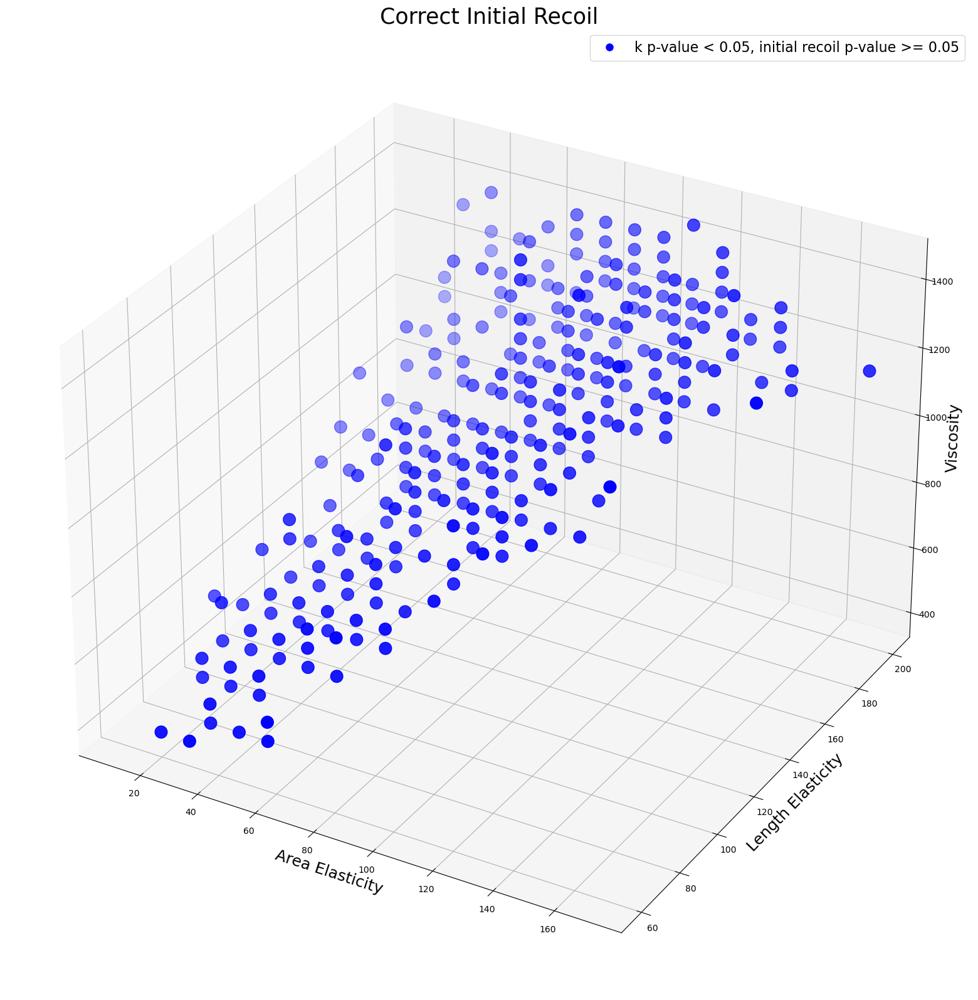

In [14]:
# Initialize lists to store data points
area_elasticity = []
length_elasticity = []
viscosity = []
colors = []

# Function to determine if the point should be blue
def is_blue(param):
    if 'issue' in param and param['issue'] == 'Displacement issue':
        return False
    k_p_value = param.get('k_p_value', None)
    initial_recoil_p_value = param.get('initial_recoil_p_value', None)
    return k_p_value is not None and initial_recoil_p_value is not None and k_p_value < 0.05 and initial_recoil_p_value >= 0.05

# Function to process parameters and ensure only blue points
def process_parameters(parameters):
    for param in parameters:
        if is_blue(param):  # Only include blue dots
            area_elasticity.append(param["area_elasticity"])
            length_elasticity.append(param["length_elasticity"])
            viscosity.append(param["viscosity"])
            colors.append('blue')

# Process all parameters
process_parameters(results['valid_parameters'])
process_parameters(results['invalid_parameters'])

# Ensure all lists have the same length
assert len(area_elasticity) == len(length_elasticity) == len(viscosity) == len(colors), "List lengths do not match"

# Create 3D scatter plot
fig = plt.figure(figsize=(20, 20))
ax = fig.add_subplot(111, projection='3d')

# Plot parameters with solid blue color
sc = ax.scatter(area_elasticity, length_elasticity, viscosity, c=colors, marker='o', s=200)

# Set labels and title
ax.set_xlabel('Area Elasticity', fontsize=18)
ax.set_ylabel('Length Elasticity', fontsize=18)
ax.set_zlabel('Viscosity', fontsize=18)
ax.set_title('Correct Initial Recoil', fontsize=25)

# Create custom legend
legend_elements = [
    Line2D([0], [0], marker='o', color='w', label='k p-value < 0.05, initial recoil p-value >= 0.05', markerfacecolor='blue', markersize=10),
]
ax.legend(handles=legend_elements, prop={'size': 16})

plt.show()

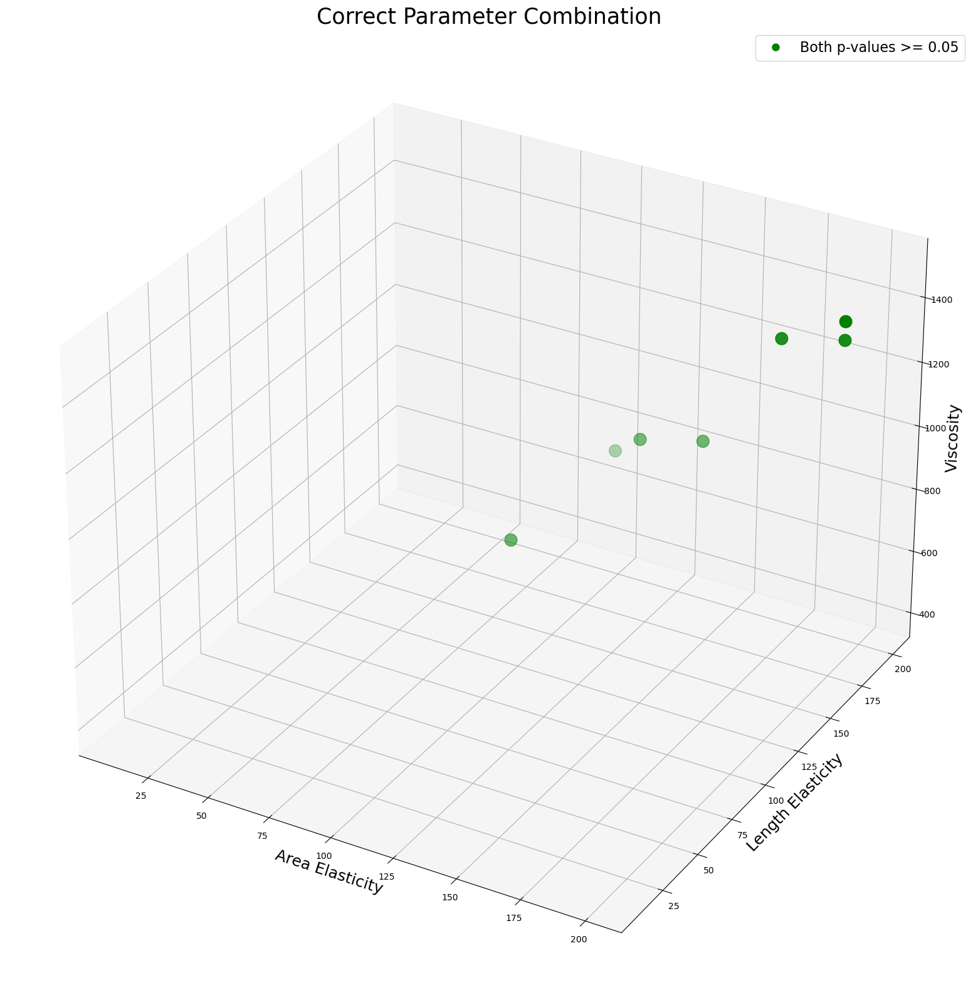

In [15]:
# Function to determine if the point should be green
def is_green(param):
    if 'issue' in param and param['issue'] == 'Displacement issue':
        return False
    k_p_value = param.get('k_p_value', None)
    initial_recoil_p_value = param.get('initial_recoil_p_value', None)
    return k_p_value is not None and initial_recoil_p_value is not None and k_p_value >= 0.05 and initial_recoil_p_value >= 0.05

# Function to process parameters and ensure only green points
def process_parameters(parameters):
    area_elasticity = []
    length_elasticity = []
    viscosity = []
    colors = []
    for param in parameters:
        if is_green(param):  # Only include green dots
            area_elasticity.append(param["area_elasticity"])
            length_elasticity.append(param["length_elasticity"])
            viscosity.append(param["viscosity"])
            colors.append('green')
    return area_elasticity, length_elasticity, viscosity, colors


# Process parameters to include only green points
green_area_elasticity, green_length_elasticity, green_viscosity, green_colors = process_parameters(results['valid_parameters'] + results['invalid_parameters'])

# Ensure all lists have the same length
assert len(green_area_elasticity) == len(green_length_elasticity) == len(green_viscosity) == len(green_colors), "List lengths do not match"

# Create 3D scatter plot with only green points
fig = plt.figure(figsize=(20, 20))
ax = fig.add_subplot(111, projection='3d')
sc = ax.scatter(green_area_elasticity, green_length_elasticity, green_viscosity, c=green_colors, marker='o', s=200)

# Set labels, title, and axis limits
ax.set_xlabel('Area Elasticity', fontsize=18)
ax.set_ylabel('Length Elasticity', fontsize=18)
ax.set_zlabel('Viscosity', fontsize=18)
ax.set_title('Correct Parameter Combination', fontsize=25)
ax.set_xlim(xlim)
ax.set_ylim(ylim)
ax.set_zlim(zlim)

# Create custom legend
legend_elements = [
    Line2D([0], [0], marker='o', color='w', label='Both p-values >= 0.05', markerfacecolor='green', markersize=10),
]
ax.legend(handles=legend_elements, prop={'size': 16})

plt.show()

Processing viscosity: 400.0
Number of points: 400


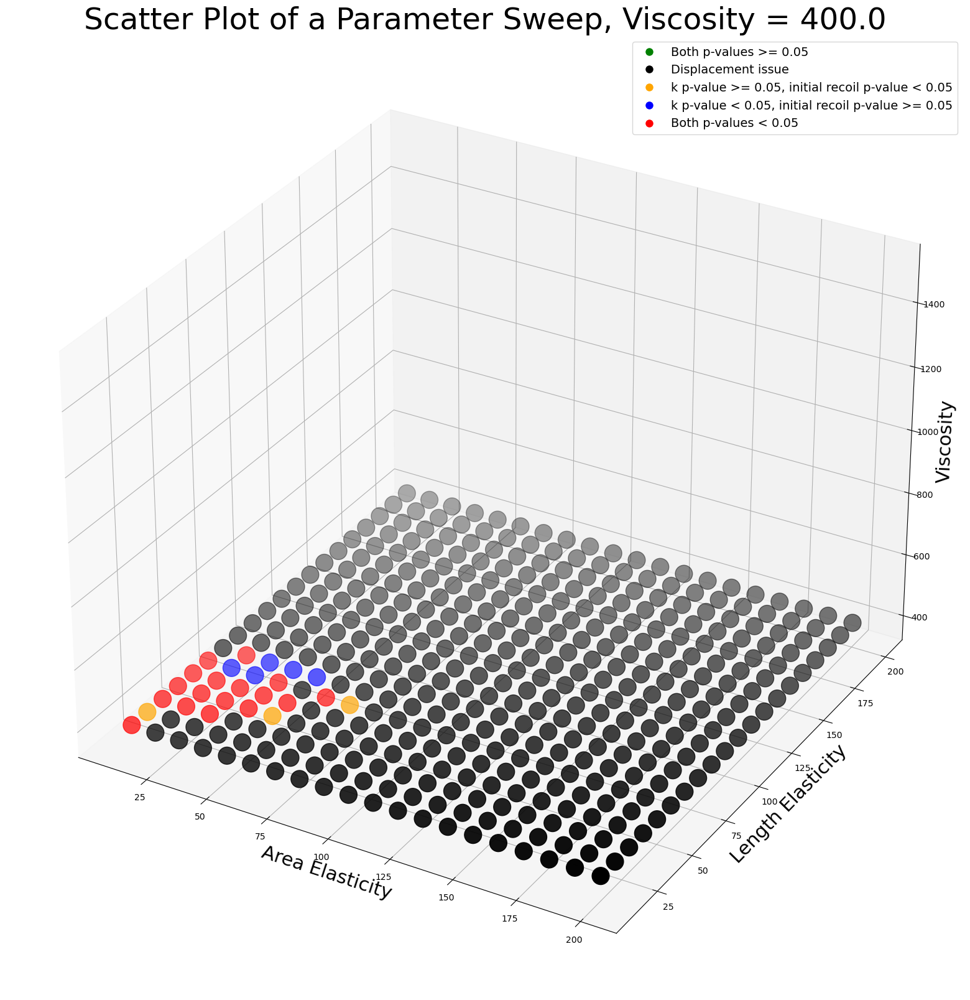

Processing viscosity: 457.89473684210526
Number of points: 400


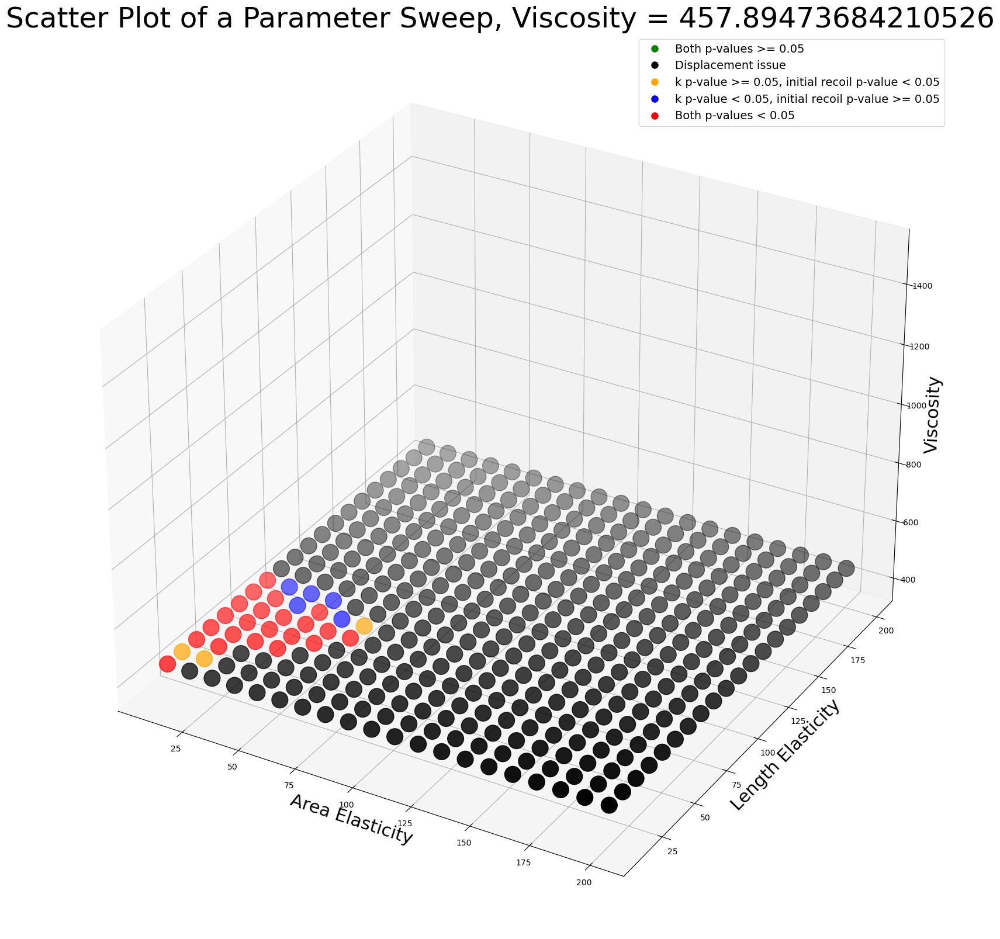

Processing viscosity: 515.7894736842105
Number of points: 400


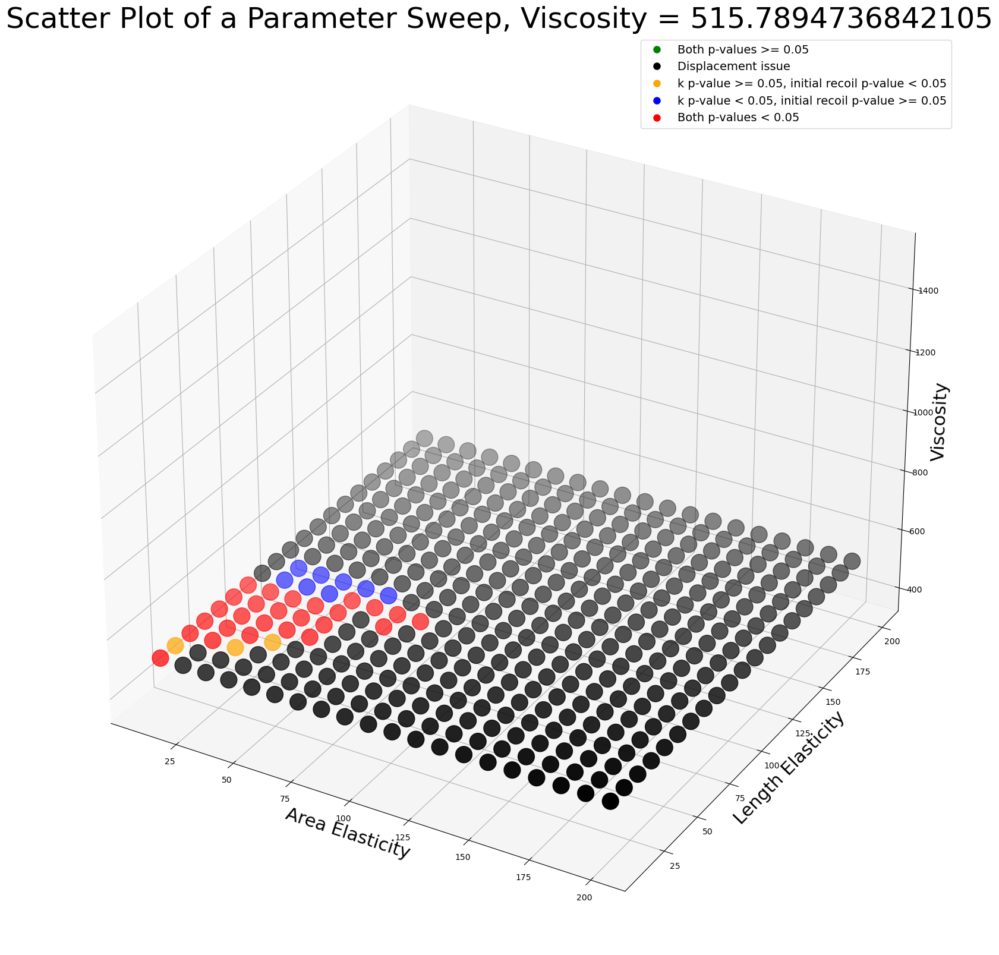

Processing viscosity: 573.6842105263158
Number of points: 400


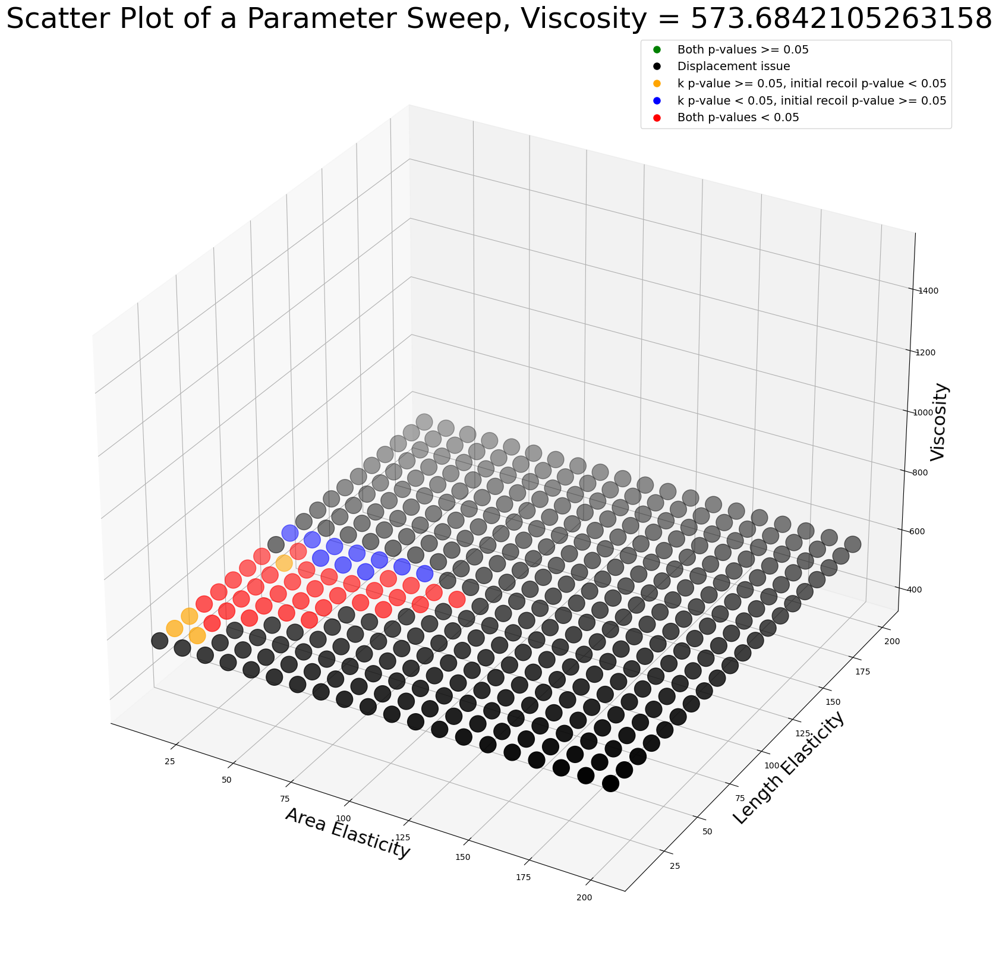

Processing viscosity: 631.578947368421
Number of points: 400


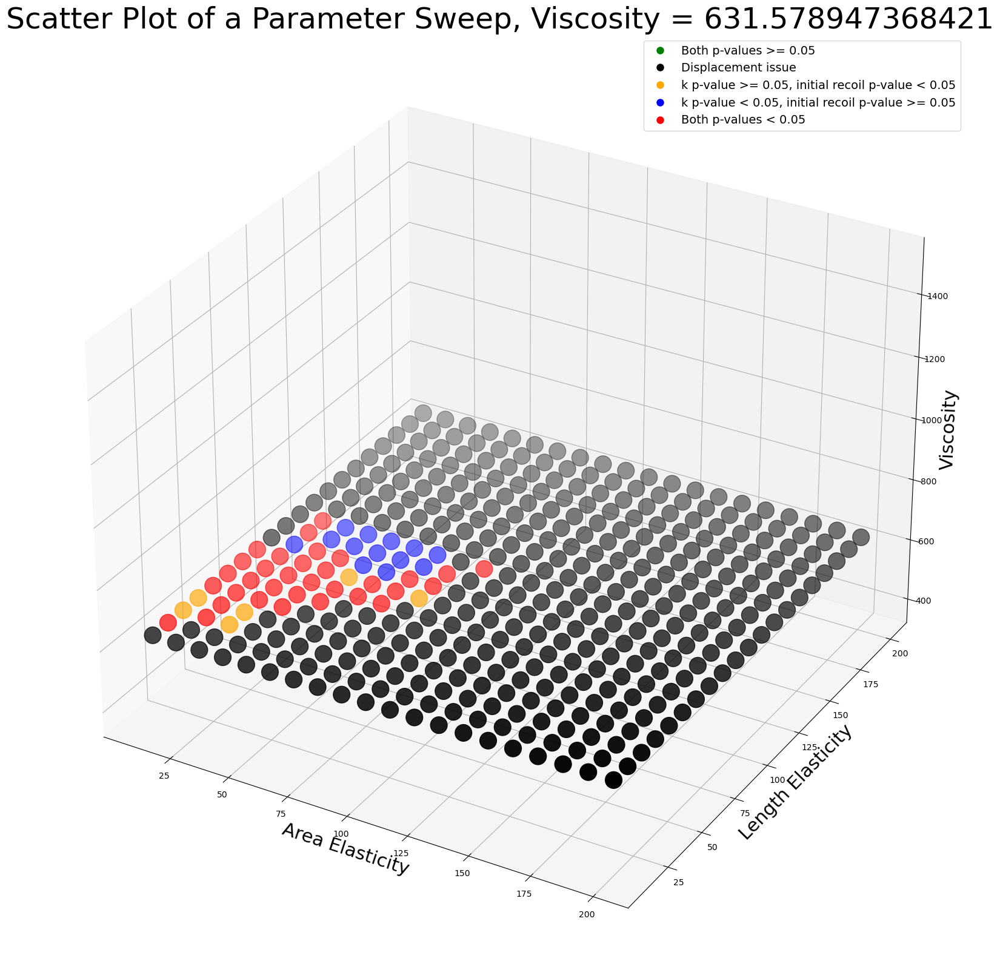

Processing viscosity: 689.4736842105262
Number of points: 400


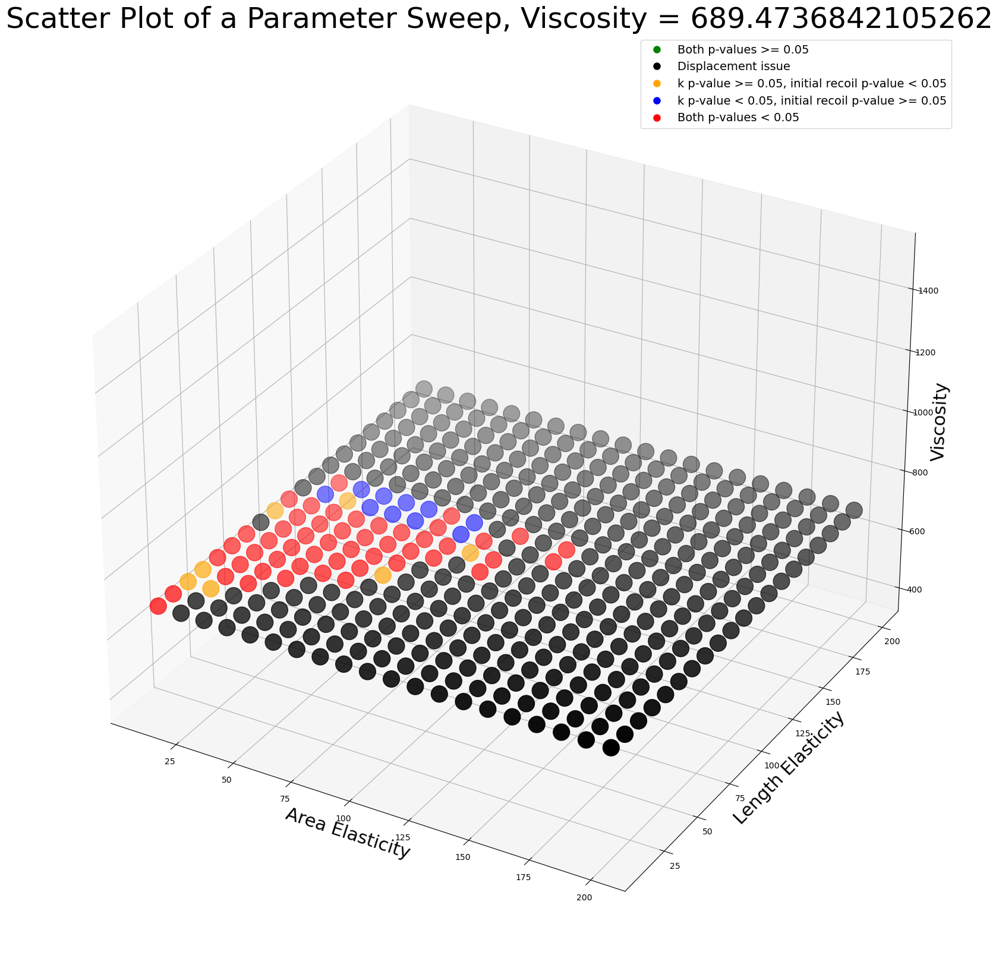

Processing viscosity: 747.3684210526316
Number of points: 400


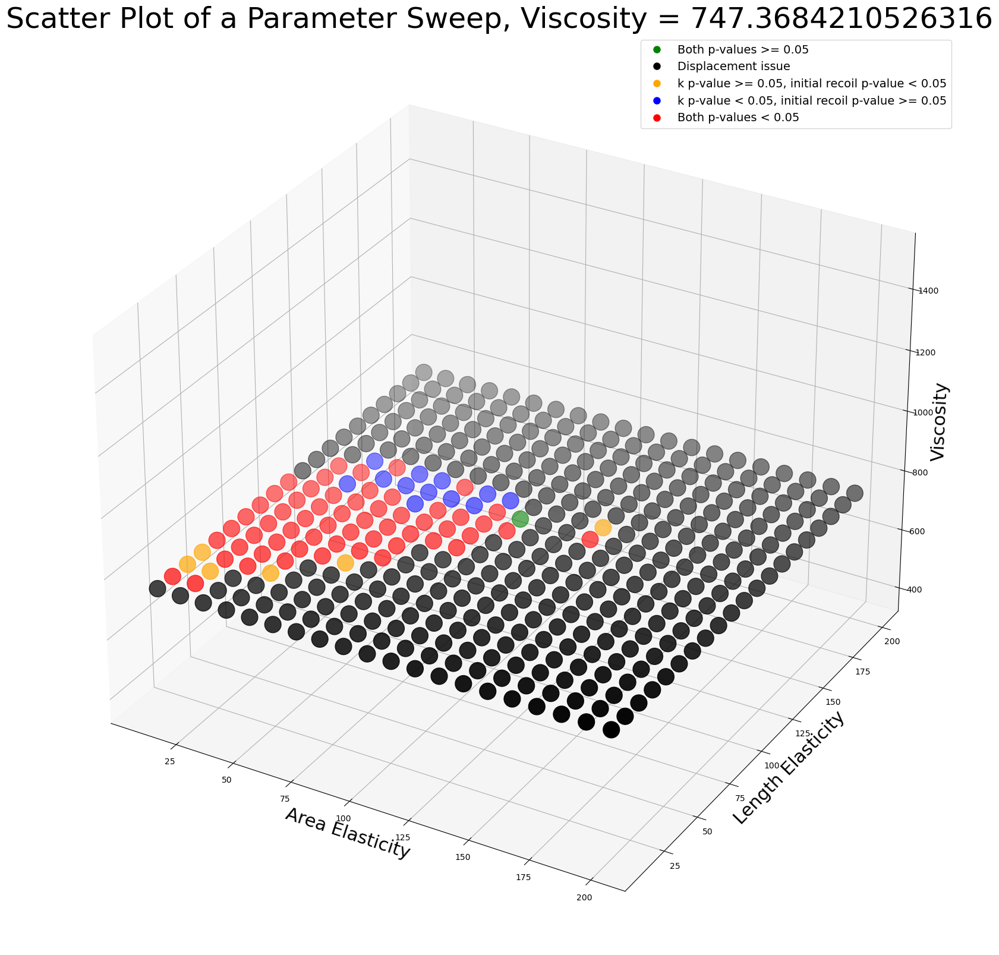

Processing viscosity: 805.2631578947369
Number of points: 400


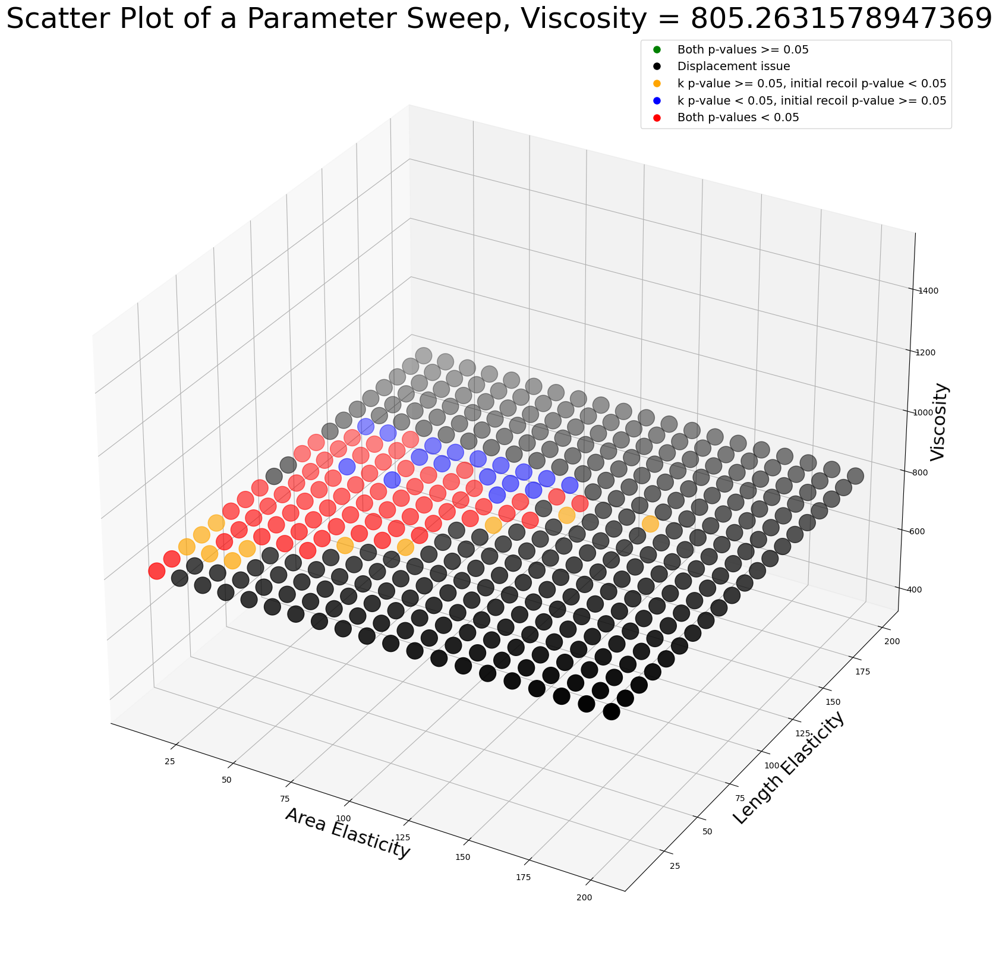

Processing viscosity: 863.1578947368421
Number of points: 400


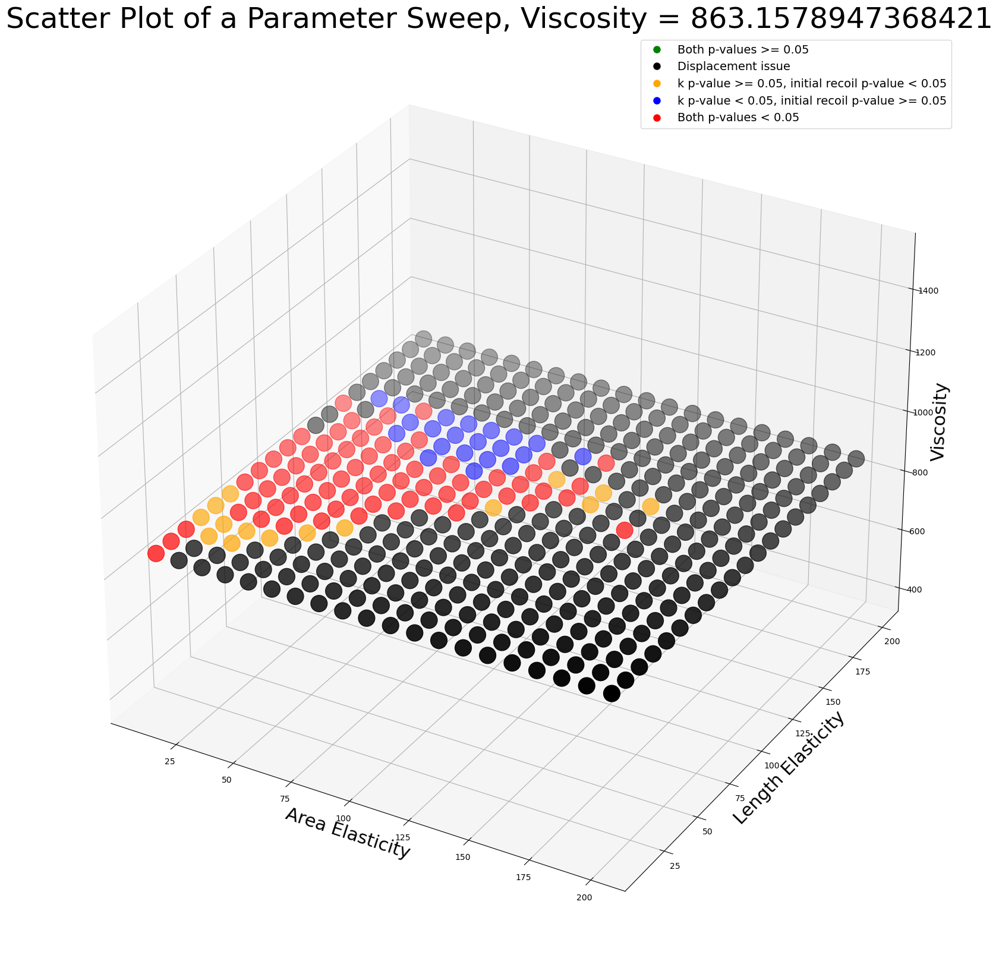

Processing viscosity: 921.0526315789473
Number of points: 400


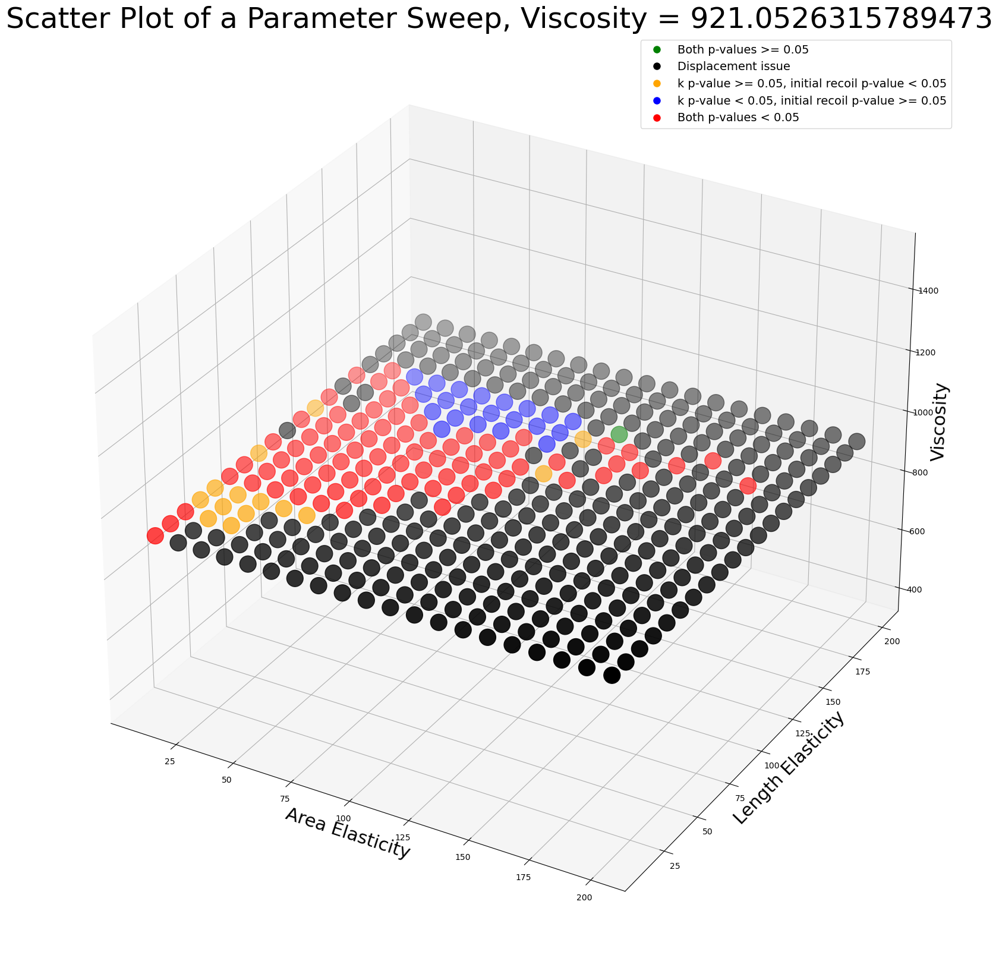

Processing viscosity: 978.9473684210526
Number of points: 400


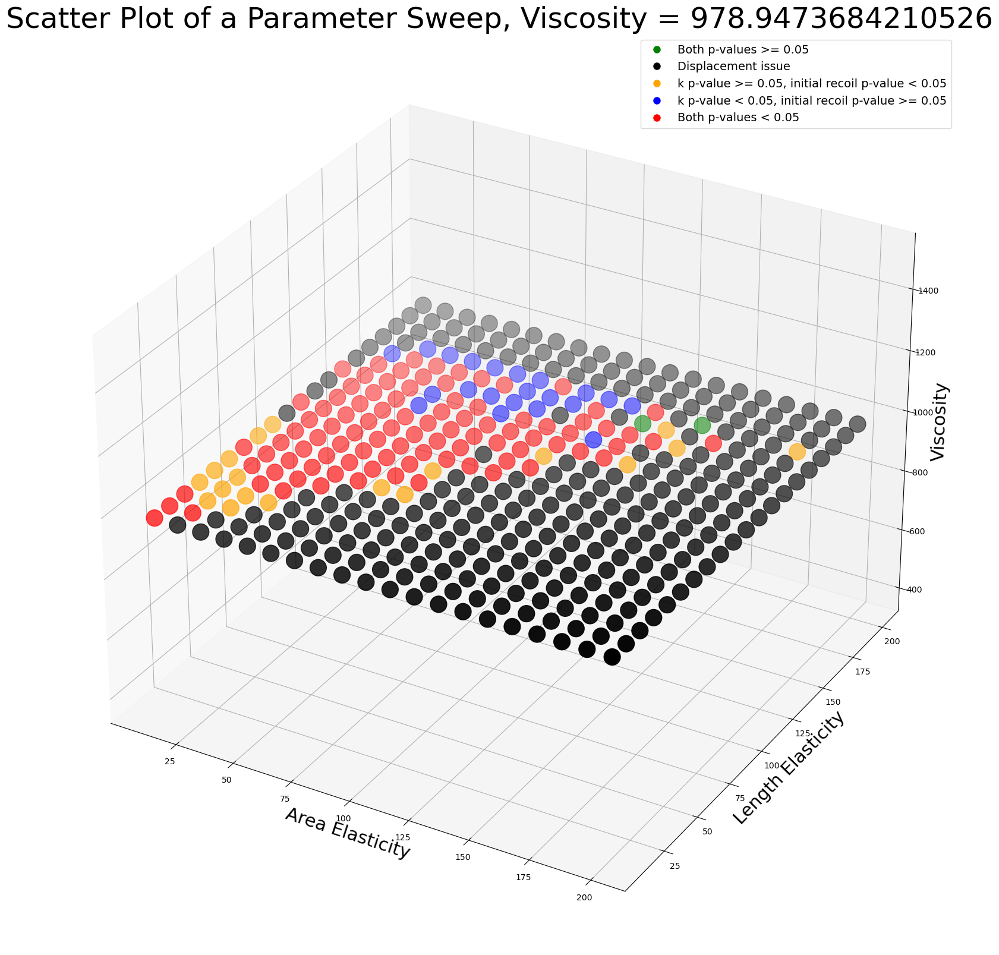

Processing viscosity: 1036.842105263158
Number of points: 400


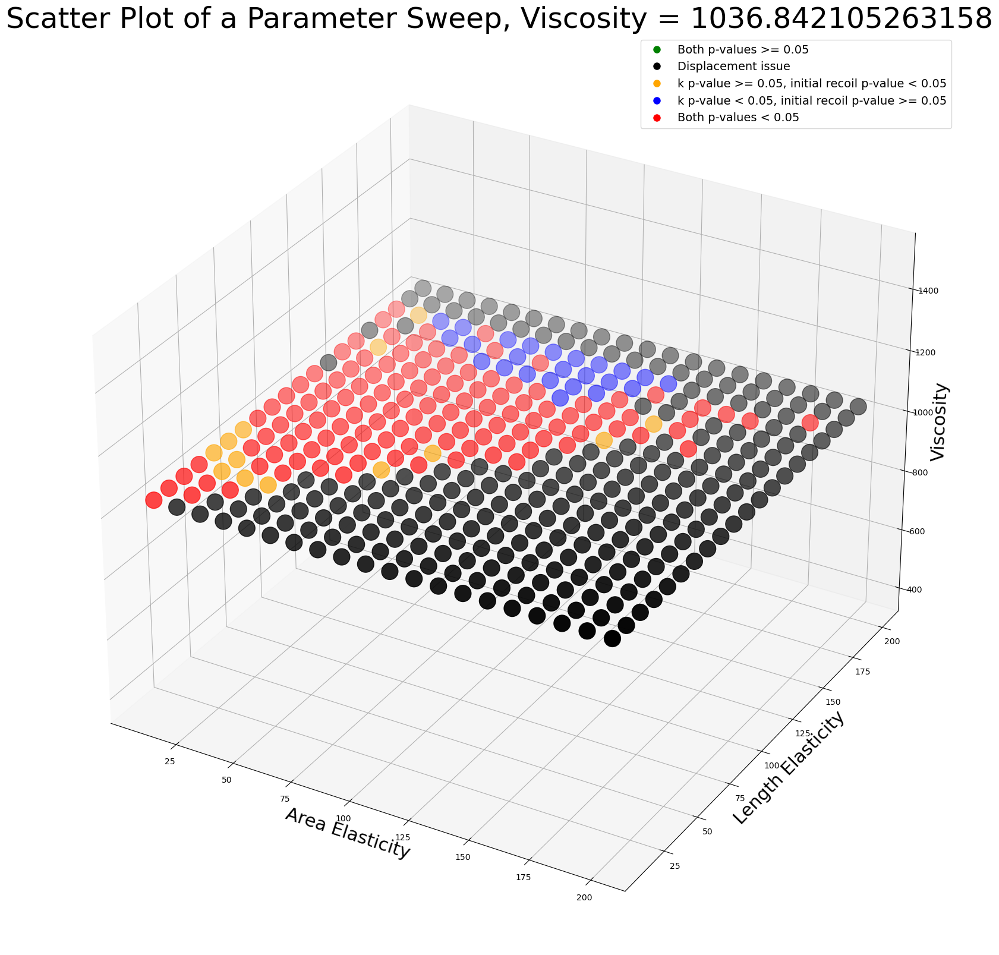

Processing viscosity: 1094.7368421052631
Number of points: 400


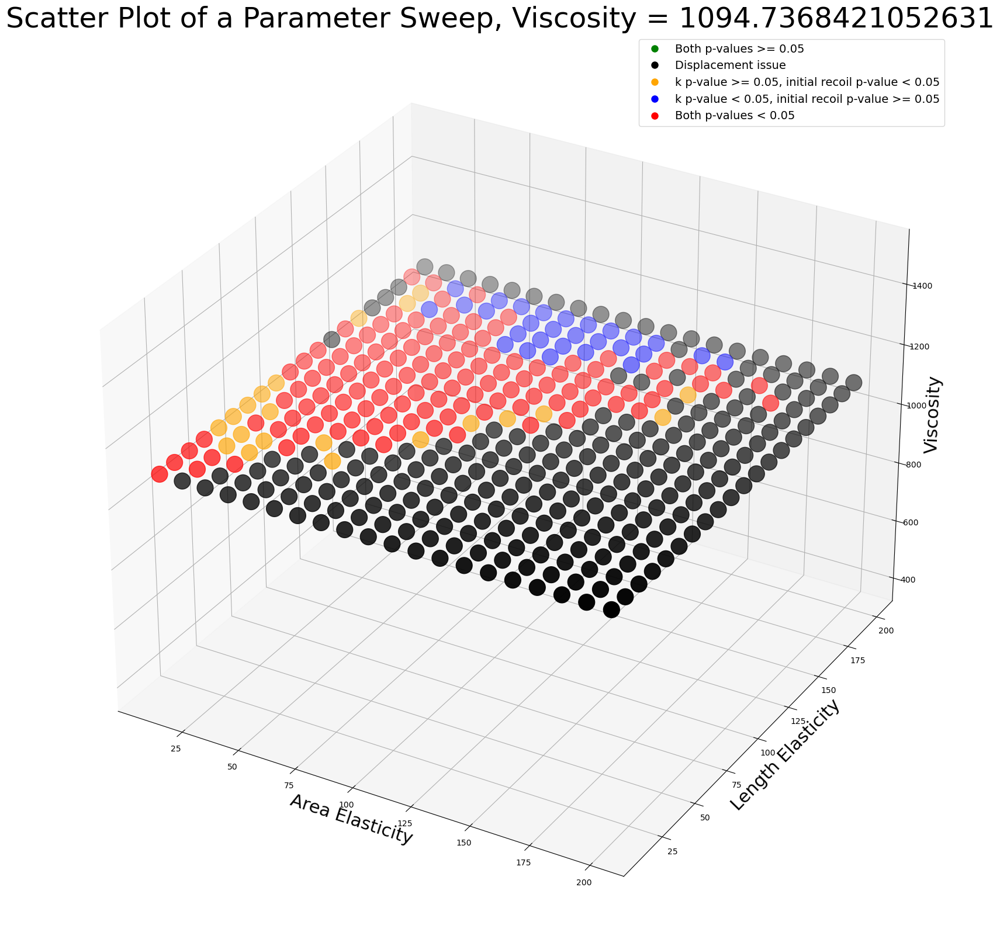

Processing viscosity: 1152.6315789473683
Number of points: 400


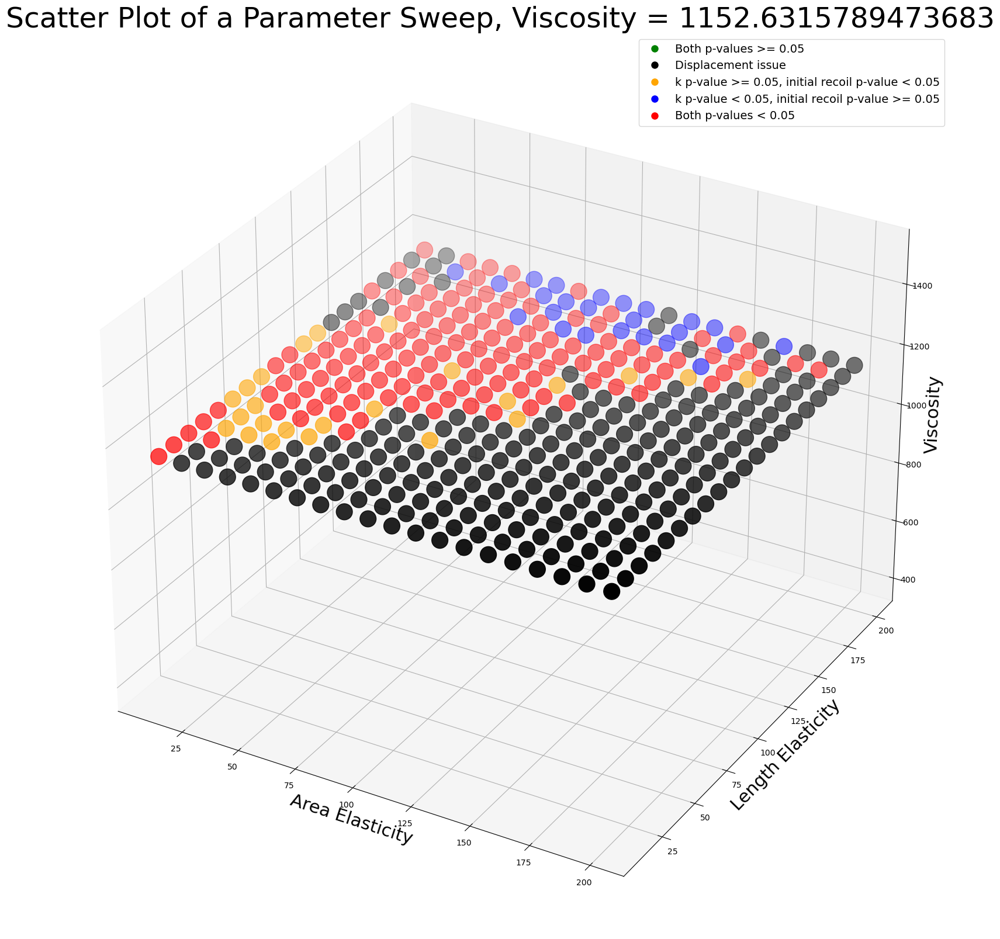

Processing viscosity: 1210.5263157894738
Number of points: 400


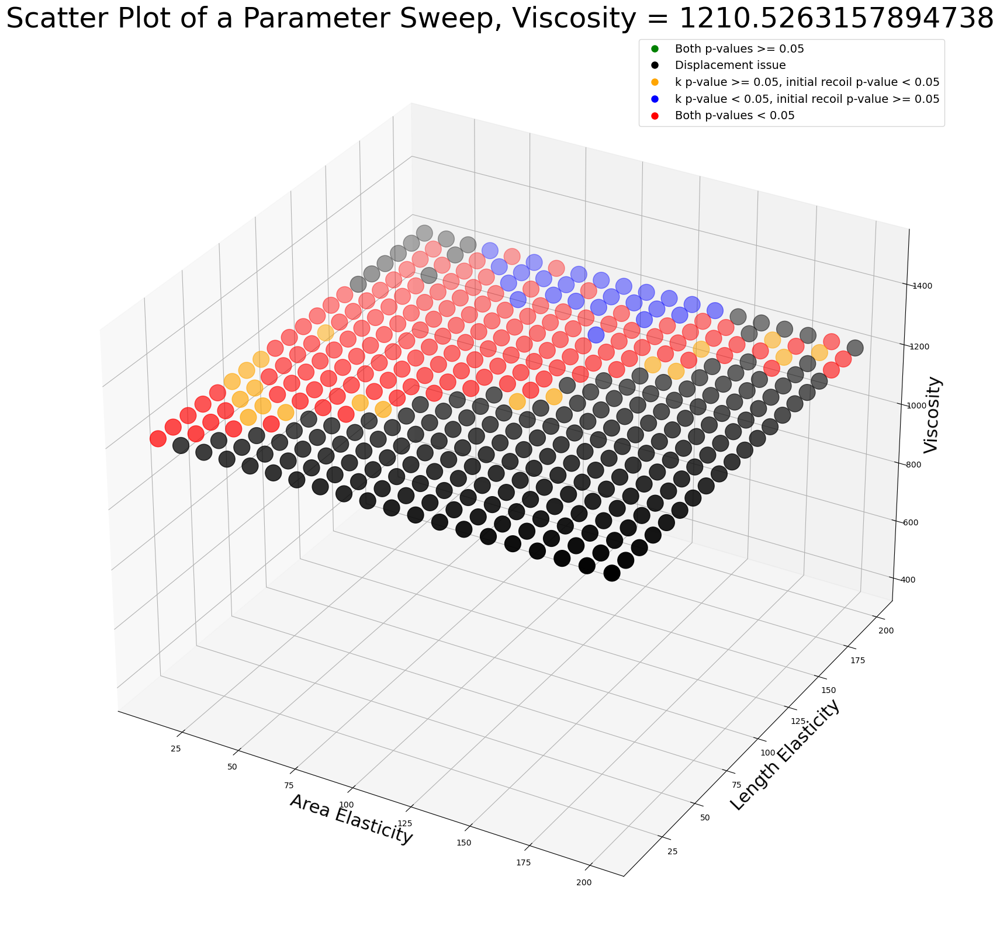

Processing viscosity: 1268.421052631579
Number of points: 400


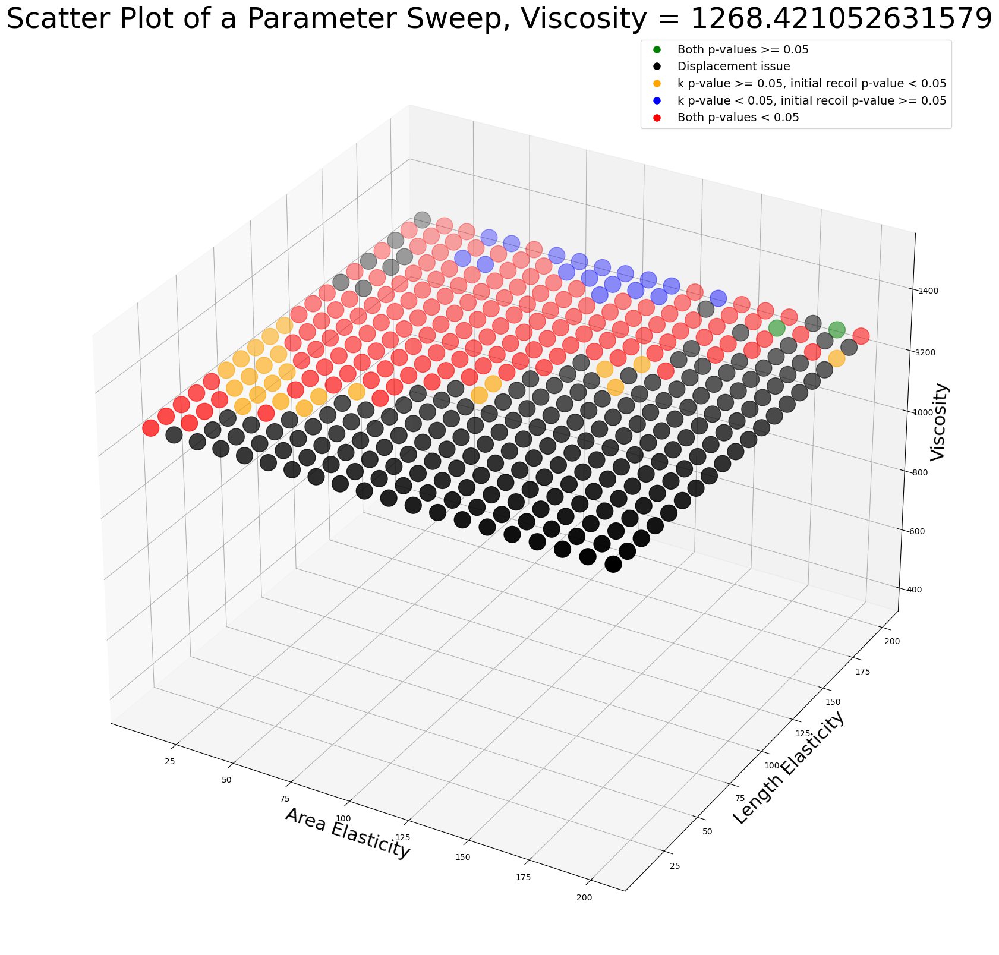

Processing viscosity: 1326.3157894736842
Number of points: 400


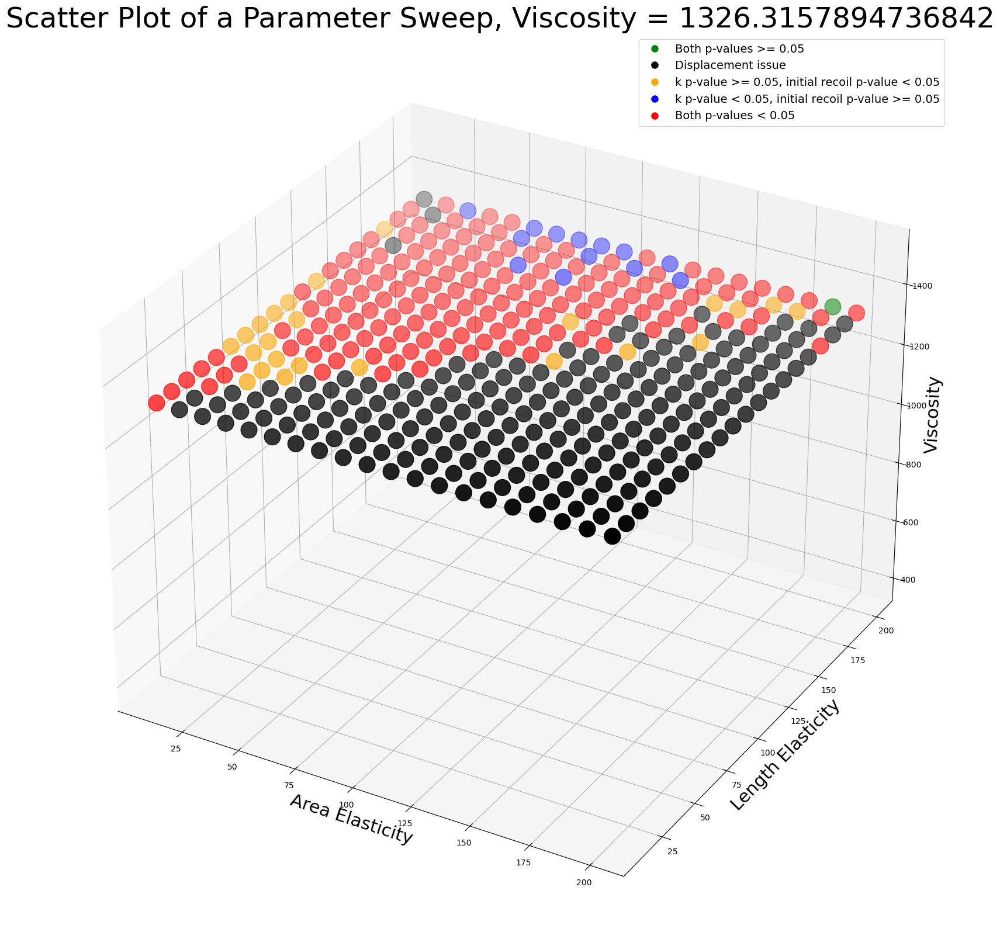

Processing viscosity: 1384.2105263157894
Number of points: 400


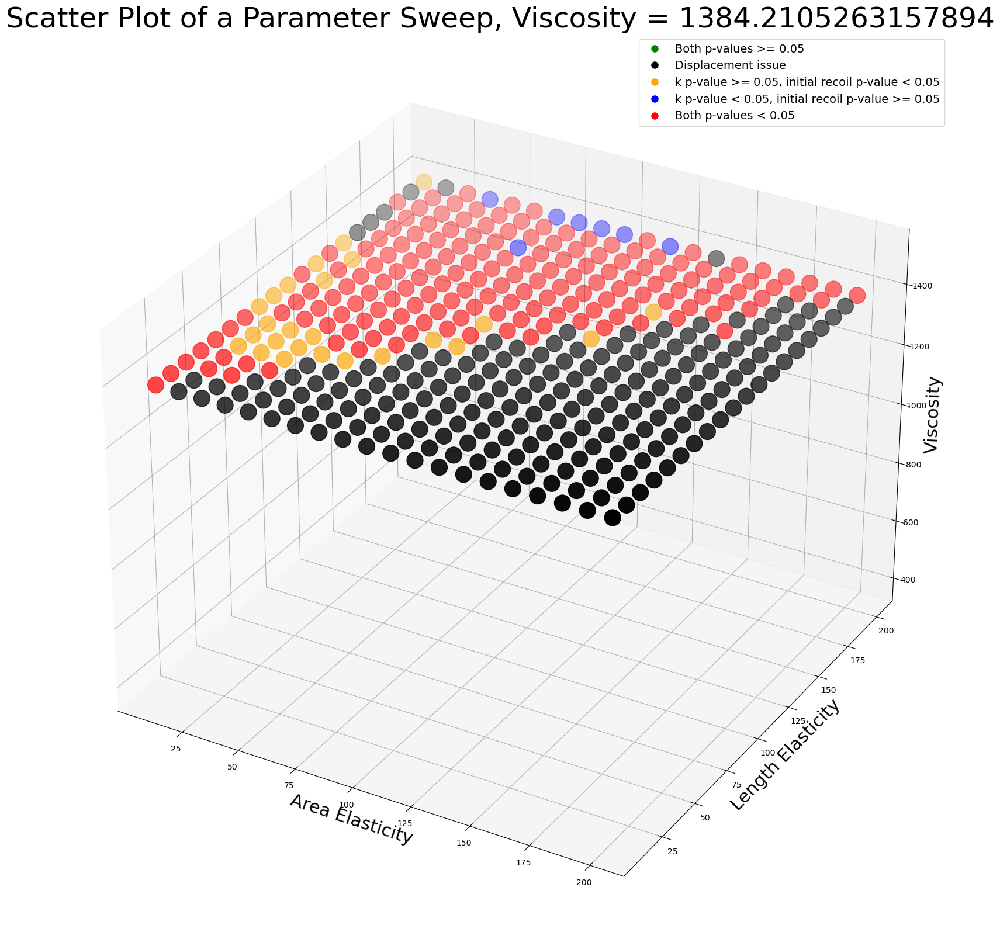

Processing viscosity: 1442.1052631578946
Number of points: 400


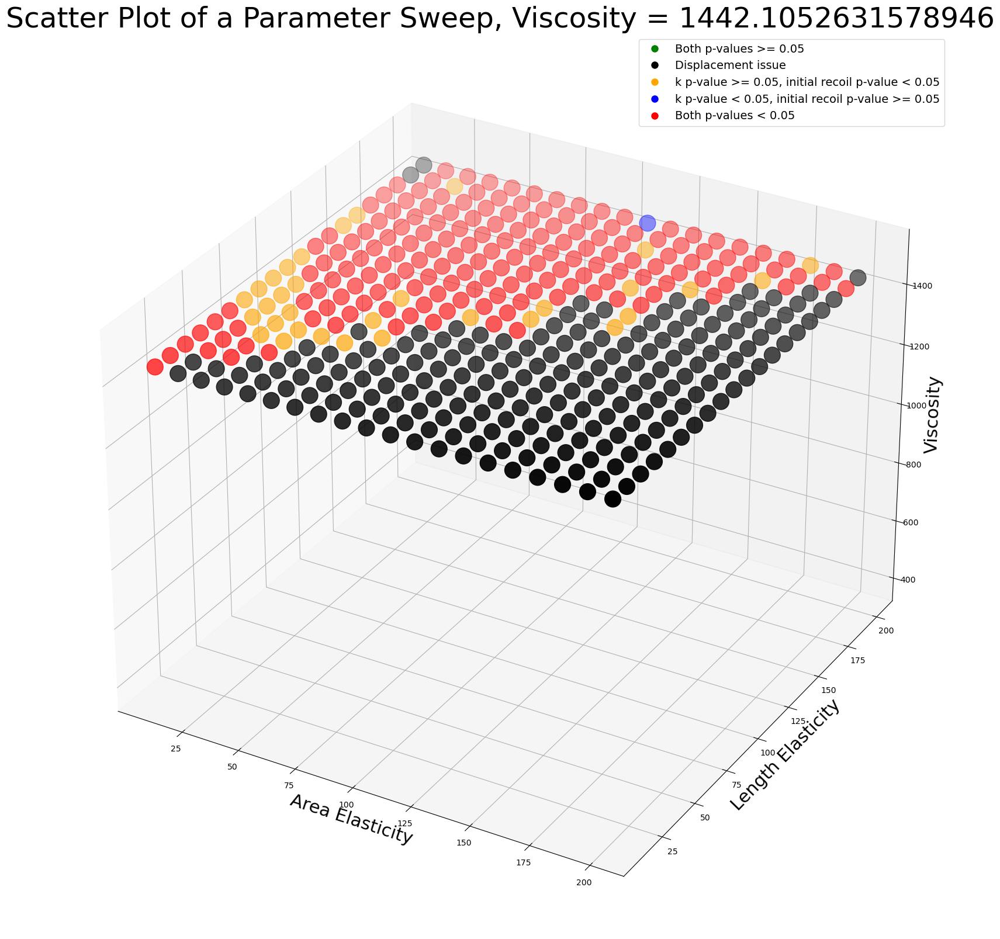

Processing viscosity: 1500.0
Number of points: 400


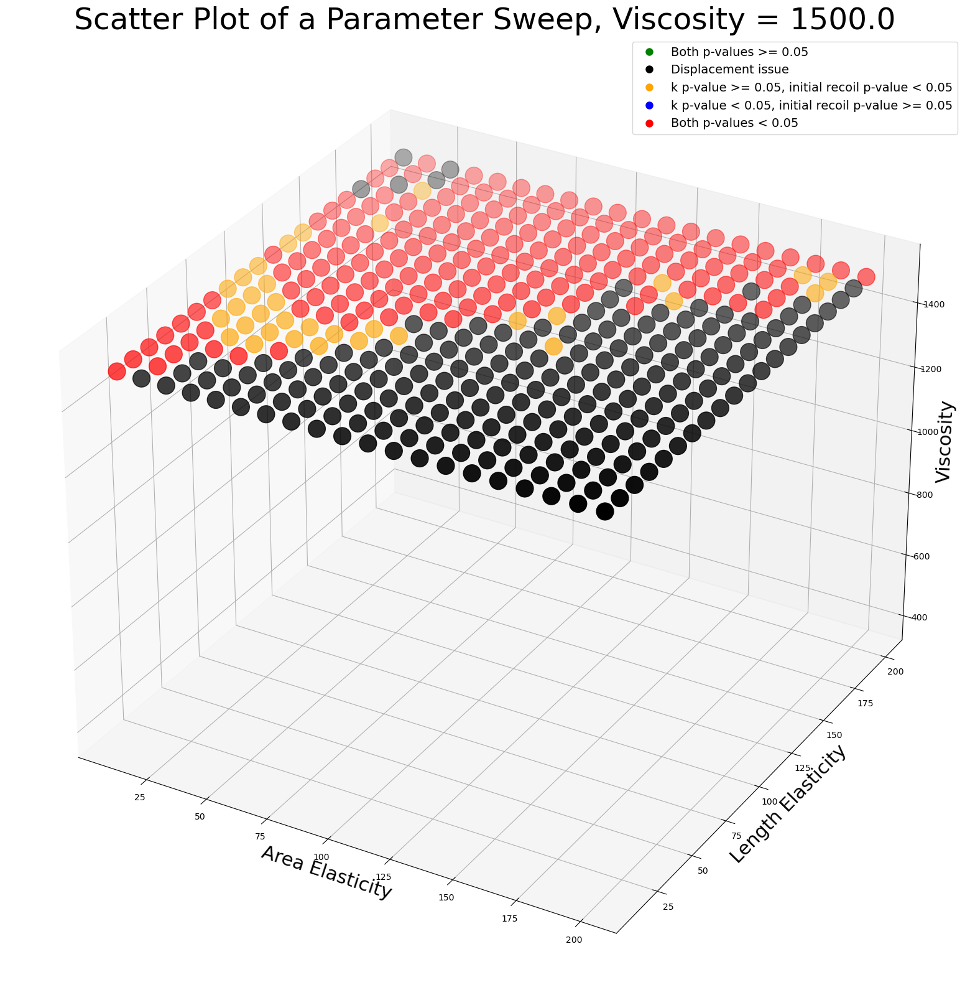

In [17]:
# Load the results from the JSON file
file_path = 'LE:10-200, AE:10-200, viscosity:400-1500 , 20steps.json'
with open(file_path) as f:
    results = json.load(f)

# Function to determine the color based on the p-values and issue
def determine_color(param):
    if 'issue' in param and param['issue'] == 'Displacement issue':
        return 'black'
    k_p_value = param.get('k_p_value', None)
    initial_recoil_p_value = param.get('initial_recoil_p_value', None)
    if k_p_value is not None and initial_recoil_p_value is not None:
        if k_p_value >= 0.05 and initial_recoil_p_value >= 0.05:
            return 'green'
        elif k_p_value >= 0.05 and initial_recoil_p_value < 0.05:
            return 'orange'
        elif k_p_value < 0.05 and initial_recoil_p_value >= 0.05:
            return 'blue'
    return 'red'  # Default to red if no specific condition is met

# Function to process parameters and ensure points fall within the chosen viscosity range
def process_parameters(parameters, viscosity_value):
    area_elasticity = []
    length_elasticity = []
    viscosity = []
    colors = []
    for param in parameters:
        if param["viscosity"] == viscosity_value:
            area_elasticity.append(param["area_elasticity"])
            length_elasticity.append(param["length_elasticity"])
            viscosity.append(param["viscosity"])
            colors.append(determine_color(param))
    return area_elasticity, length_elasticity, viscosity, colors

# Extract unique viscosity values from the dataset
unique_viscosities = sorted({param["viscosity"] for param in results['valid_parameters'] + results['invalid_parameters']})

# Loop through each unique viscosity and generate a plot
for viscosity in unique_viscosities:
    print(f'Processing viscosity: {viscosity}')  # Debug print
    area_elasticity, length_elasticity, viscosity_values, colors = process_parameters(
        results['valid_parameters'] + results['invalid_parameters'],
        viscosity
    )
    print(f'Number of points: {len(area_elasticity)}')  # Debug print

    # Ensure all lists have the same length
    assert len(area_elasticity) == len(length_elasticity) == len(viscosity_values) == len(colors), "List lengths do not match"

    # Create 3D scatter plot
    fig = plt.figure(figsize=(20, 20))
    ax = fig.add_subplot(111, projection='3d')

    # Plot parameters with determined colors
    sc = ax.scatter(area_elasticity, length_elasticity, viscosity_values, c=colors, marker='o', s=400)

    # Set labels and title
    ax.set_xlabel('Area Elasticity', fontsize=22)
    ax.set_ylabel('Length Elasticity', fontsize=22)
    ax.set_zlabel('Viscosity', fontsize=22)
    ax.set_title(f'Scatter Plot of a Parameter Sweep, Viscosity = {viscosity}', fontsize=35)
    ax.set_zlim(0, 700)

    # Apply captured axis limits (you should define xlim, ylim, zlim earlier)
    ax.set_xlim(xlim)
    ax.set_ylim(ylim)
    ax.set_zlim(zlim)

    # Create custom legend
    legend_elements = [
        Line2D([0], [0], marker='o', color='w', label='Both p-values >= 0.05', markerfacecolor='green', markersize=10),
        Line2D([0], [0], marker='o', color='w', label='Displacement issue', markerfacecolor='black', markersize=10),
        Line2D([0], [0], marker='o', color='w', label='k p-value >= 0.05, initial recoil p-value < 0.05', markerfacecolor='orange', markersize=10),
        Line2D([0], [0], marker='o', color='w', label='k p-value < 0.05, initial recoil p-value >= 0.05', markerfacecolor='blue', markersize=10),
        Line2D([0], [0], marker='o', color='w', label='Both p-values < 0.05', markerfacecolor='red', markersize=10),
    ]
    ax.legend(handles=legend_elements, prop={'size': 14})

    # Show or save the plot
    plt.show()  # or plt.savefig(f'plot_viscosity_{viscosity:.2f}.png')

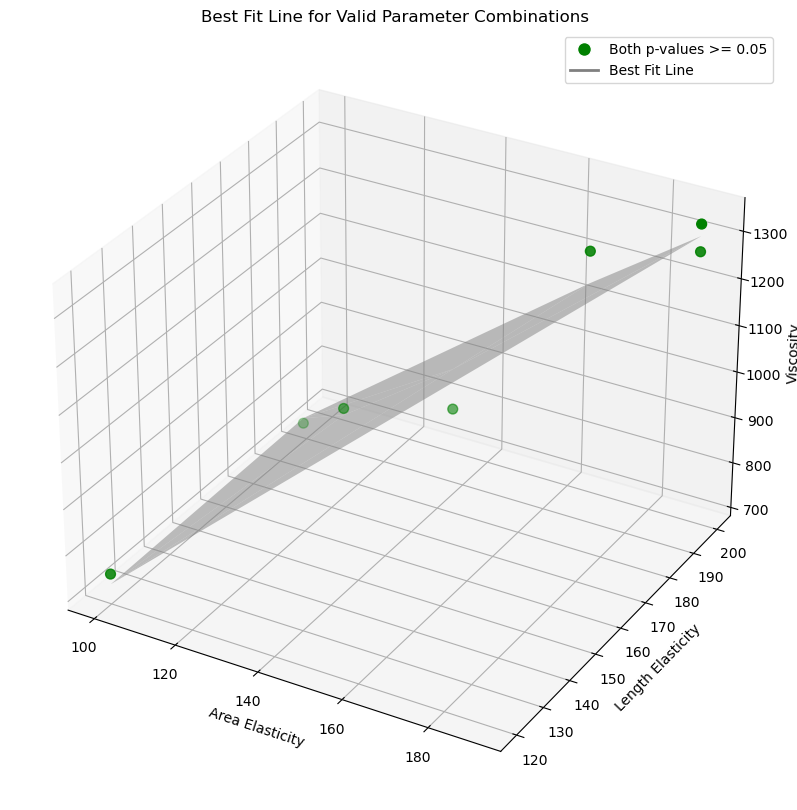

In [18]:
import json
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
from sklearn.linear_model import LinearRegression
from matplotlib.lines import Line2D

# Load the results from the JSON file
file_path = 'LE:10-200, AE:10-200, viscosity:400-1500 , 20steps.json'
with open(file_path) as f:
    results = json.load(f)

# Function to determine if the point should be green
def is_green(param):
    if 'issue' in param and param['issue'] == 'Displacement issue':
        return False
    k_p_value = param.get('k_p_value', None)
    initial_recoil_p_value = param.get('initial_recoil_p_value', None)
    return k_p_value is not None and initial_recoil_p_value is not None and k_p_value >= 0.05 and initial_recoil_p_value >= 0.05

# Extract the valid green parameter combinations
green_params = [param for param in results['valid_parameters'] + results['invalid_parameters'] if is_green(param)]

# Extract the parameters for green points
green_area_elasticity = np.array([param["area_elasticity"] for param in green_params]).reshape(-1, 1)
green_length_elasticity = np.array([param["length_elasticity"] for param in green_params]).reshape(-1, 1)
green_viscosity = np.array([param["viscosity"] for param in green_params]).reshape(-1, 1)

# Prepare the data for linear regression
X = np.hstack([green_area_elasticity, green_length_elasticity])
y = green_viscosity

# Perform linear regression
model = LinearRegression()
model.fit(X, y)
y_pred = model.predict(X)

# Create a 3D scatter plot with green points and the best fit line
fig = plt.figure(figsize=(12, 10))
ax = fig.add_subplot(111, projection='3d')

# Scatter plot of the green points
ax.scatter(green_area_elasticity, green_length_elasticity, green_viscosity, color='green', label='Valid Params', s=50)

# Plot the best fit line
ax.plot_trisurf(green_area_elasticity.ravel(), green_length_elasticity.ravel(), y_pred.ravel(), color='gray', alpha=0.5)

# Set labels and title
ax.set_xlabel('Area Elasticity')
ax.set_ylabel('Length Elasticity')
ax.set_zlabel('Viscosity')
ax.set_title('Best Fit Line for Valid Parameter Combinations')

# Create custom legend
legend_elements = [
    Line2D([0], [0], marker='o', color='w', label='Both p-values >= 0.05', markerfacecolor='green', markersize=10),
    Line2D([0], [0], color='gray', lw=2, label='Best Fit Line')
]
ax.legend(handles=legend_elements, prop={'size': 10})

plt.show()


Equation of the best fit line: Viscosity = 3.2500 * Area Elasticity + 3.5395 * Length Elasticity + -24.3421


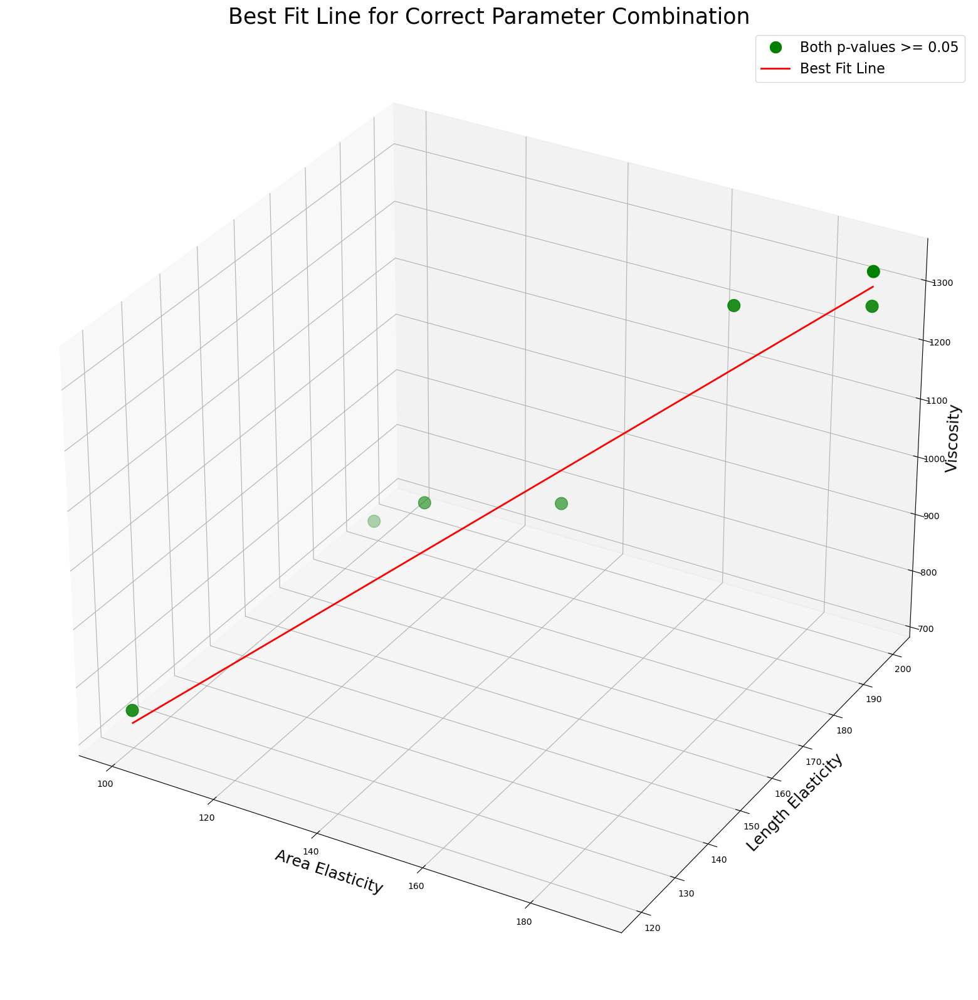

In [20]:
import json
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
from sklearn.linear_model import LinearRegression
from matplotlib.lines import Line2D

# Load the results from the JSON file
file_path = 'LE:10-200, AE:10-200, viscosity:400-1500 , 20steps.json'
with open(file_path) as f:
    results = json.load(f)

# Function to determine if the point should be green
def is_green(param):
    if 'issue' in param and param['issue'] == 'Displacement issue':
        return False
    k_p_value = param.get('k_p_value', None)
    initial_recoil_p_value = param.get('initial_recoil_p_value', None)
    return k_p_value is not None and initial_recoil_p_value is not None and k_p_value >= 0.05 and initial_recoil_p_value >= 0.05

# Function to process parameters and ensure only green points
def process_parameters(parameters):
    area_elasticity = []
    length_elasticity = []
    viscosity = []
    colors = []
    for param in parameters:
        if is_green(param):  # Only include green dots
            area_elasticity.append(param["area_elasticity"])
            length_elasticity.append(param["length_elasticity"])
            viscosity.append(param["viscosity"])
            colors.append('green')
    return area_elasticity, length_elasticity, viscosity, colors

# Process parameters to include only green points
green_area_elasticity, green_length_elasticity, green_viscosity, green_colors = process_parameters(results['valid_parameters'] + results['invalid_parameters'])

# Ensure all lists have the same length
assert len(green_area_elasticity) == len(green_length_elasticity) == len(green_viscosity) == len(green_colors), "List lengths do not match"

# Prepare the data for fitting
X = np.array(list(zip(green_area_elasticity, green_length_elasticity)))
y = np.array(green_viscosity)

# Fit the linear regression model
model = LinearRegression().fit(X, y)
predicted_viscosity = model.predict(X)

# Extract the coefficients and intercept
coef = model.coef_
intercept = model.intercept_

# Print the equation of the best fit line
print(f"Equation of the best fit line: Viscosity = {coef[0]:.4f} * Area Elasticity + {coef[1]:.4f} * Length Elasticity + {intercept:.4f}")

# Generate points along the best fit line
line_area_elasticity = np.linspace(min(green_area_elasticity), max(green_area_elasticity), 100)
line_length_elasticity = np.linspace(min(green_length_elasticity), max(green_length_elasticity), 100)
line_viscosity = coef[0] * line_area_elasticity + coef[1] * line_length_elasticity + intercept

# Create 3D scatter plot with only green points and the best fit line
fig = plt.figure(figsize=(20, 20))
ax = fig.add_subplot(111, projection='3d')

# Plot the green dots
sc = ax.scatter(green_area_elasticity, green_length_elasticity, green_viscosity, c=green_colors, marker='o', s=200)

# Plot the best fit line
ax.plot(line_area_elasticity, line_length_elasticity, line_viscosity, color='r', linewidth=2, label='Best Fit Line')

# Set labels, title, and axis limits
ax.set_xlabel('Area Elasticity', fontsize=18)
ax.set_ylabel('Length Elasticity', fontsize=18)
ax.set_zlabel('Viscosity', fontsize=18)
ax.set_title('Best Fit Line for Correct Parameter Combination', fontsize=25)

# Create custom legend
legend_elements = [
    Line2D([0], [0], marker='o', color='w', label='Both p-values >= 0.05', markerfacecolor='green', markersize=1),
    Line2D([0], [0], color='r', lw=2, label='Best Fit Line')
]
ax.legend(handles=legend_elements, prop={'size': 16})

plt.show()


In [ ]:
def find_best_parameters(num_repeats):
    
    length_elasticity_values = np.linspace(10.0, 100.0, 20)
    area_elasticity_values = np.linspace(10.0, 100.0, 20)
    viscosity_values = np.linspace(400.0, 700.0, 8)
 
    # Ex vivo values
    ex_vivo_initial_recoils = [0.02095, 0.02398, 0.04687, 0.009687, 0.009067, 0.07311, 0.06121, 0.03456, 0.02192, 0.02439, 0.01595, 0.02591, 0.06101]
        
    
    ex_vivo_k_values = [0.115, 0.1612, 0.1352, 0.06218, 0.09093, 0.1076, 0.18110, 0.1817, 0.14450, 0.1371, 0.1277, 0.1693, 0.2077]
    
    results = {
        "valid_parameters": [],
        "invalid_parameters": []
    }


    for length_elasticity in length_elasticity_values:
        for area_elasticity in area_elasticity_values:
            for viscosity in viscosity_values:
                k_values = np.zeros((num_repeats,))
                initial_recoil_values = np.zeros((num_repeats,))
                
                skip_combination = False  # Flag to skip the combination
                
                for repeat in range(num_repeats):
                    while True:
                        try:
                            print(f"Running simulation for Length Elasticity: {length_elasticity}, Area Elasticity: {area_elasticity}, Viscosity: {viscosity}, Repeat: {repeat+1}")
                            
                            # Initialize Model
                            [cellmap_init, geom, energyContributions_model] = vertexModel.initialize()

                            ## Update mechanical parameters
                            cellmap_init = inputMechanicalParameters.update(cellmap_init)
                
                            ## Initial stage
                            energyContributions_model.compute_energy(cellmap_init)

                            ## RUN
                            [cellmap_H, geom, model_H, history_H, solver1] = vertexModel.solveEuler(cellmap_init, geom, energyContributions_model, endTime = 100)


                            # Update mechanical parameters
                            cellmap_H.face_df['area_elasticity'] = area_elasticity
                            cellmap_H.edge_df['length_elasticity'] = length_elasticity
                            cellmap_H.vert_df['viscosity'] = viscosity
                            
                            
                            ## Initial stage
                            energyContributions_model.compute_energy(cellmap_H)

                            ## RUN
                            [cellmap_H, geom, model_H, history_H, solver1] = vertexModel.solveEuler(cellmap_H, geom, energyContributions_model, endTime = 100)

                            print(cellmap_H.edge_df["length_elasticity"])
                            print(cellmap_H.face_df["area_elasticity"])
                            print(cellmap_H.vert_df["viscosity"])
                            
                            
                            # In silico laser ablation
                            edges_without_opposites_indices, border_edges_indices = cellDivision.edges_list_without_opposites(cellmap_H)
                            chosen_edge = random.choice(edges_without_opposites_indices)
                            srce, trgt = cellmap_H.edge_df.loc[chosen_edge, ["srce", "trgt"]]
                            opposite_edge = cellmap_H.edge_df[(cellmap_H.edge_df["srce"] == trgt) & (cellmap_H.edge_df["trgt"] == srce)].index.tolist()[0]
                            both_edges = [chosen_edge, opposite_edge]
                            faces_ids = cellmap_H.edge_df.loc[both_edges]['face'].tolist()
                            srce_vert = cellmap_H.edge_df.loc[chosen_edge, 'srce']
                            trgt_vert = cellmap_H.edge_df.loc[chosen_edge, 'trgt']
                            initial_coords_srce_vert = cellmap_H.vert_df.loc[srce_vert, ['x', 'y']]
                            initial_coords_trgt_vert = cellmap_H.vert_df.loc[trgt_vert, ['x', 'y']]
                            cellmap_H.edge_df.loc[cellmap_H.edge_df['face'] == faces_ids[0], 'face'] = faces_ids[1]
                            cellmap_H.face_df = cellmap_H.face_df.drop(faces_ids[0])
                            cellmap_H.edge_df = cellmap_H.edge_df.drop(both_edges)
                            cellmap_H.reset_index()

                            energyContributions_model.compute_energy(cellmap_H)
                            [cellmap_H, geom, model_H, history_H, solver1] = vertexModel.solveEuler(cellmap_H, geom, energyContributions_model, 50)


                            # Store the distances for plotting
                            displacement = []
                            time_steps = []
                            initial_distance = np.sqrt(
                                (initial_coords_srce_vert['x'] - initial_coords_trgt_vert['x']) ** 2 +
                                (initial_coords_srce_vert['y'] - initial_coords_trgt_vert['y']) ** 2
                            )
                            displacement.append(0)  # Initial extra distance is zero
                            time_steps.append(0)

                            for t, cellmap in solver1.history:
                                current_coords_srce_vert = cellmap.vert_df.loc[srce_vert, ['x', 'y']]
                                current_coords_trgt_vert = cellmap.vert_df.loc[trgt_vert, ['x', 'y']]
                                distance = np.sqrt(
                                    (current_coords_srce_vert['x'] - current_coords_trgt_vert['x']) ** 2 +
                                    (current_coords_srce_vert['y'] - current_coords_trgt_vert['y']) ** 2
                                )
                                extra_distance = distance - initial_distance
                                displacement.append(extra_distance)
                                time_steps.append(t)

                            # Plotting the extra distances
                            plt.figure(figsize=(10, 6))
                            plt.plot(time_steps, displacement, marker='o', linestyle='-', color='skyblue', label='Extra Distance between Source and Target Vertices')
                            plt.show()
                            
                            # Check for monotonic increasing displacement with threshold
                            if not is_monotonic_increasing(displacement, threshold=0.001):
                                print("Displacement goes down, skipping repeat.")
                                skip_combination = True  # Set flag to skip the combination
                                results["invalid_parameters"].append({
                                    "area_elasticity": area_elasticity,
                                    "length_elasticity": length_elasticity,
                                    "viscosity": viscosity,
                                    "issue": "Displacement issue"
                                })
                                
                                print("added to invalid params")
                                break  # Skip remaining repeats for this combination

                            def recoil_model(x, initialrecoil, K):
                                return (initialrecoil / K) * (1 - np.exp(-K * x))

                            # Fit the model with initial guesses and constraints
                            params, covariance = curve_fit(
                                recoil_model, time_steps, displacement, 
                                p0=[0.00001, 3], bounds=(0, np.inf)
                            )
                            initialrecoil, K = params
                            
                            k_values[repeat] = K
                            initial_recoil_values[repeat] = initialrecoil
                            
                            
                            print(f"K value = {K}")
                            print(f"Initial recoil value = {initialrecoil}")
                            
                            # Break the loop if no exception occurs
                            break

                        except Exception as e:
                            print(f"An error occurred: {e}. Retrying this repeat.")
                            continue  # Retry the repeat

                    if skip_combination:
                        break  # Skip the remaining repeats and move to the next parameter combination
                
                if skip_combination:
                    continue  # Skip to the next parameter combination

                if np.all(~np.isnan(k_values)) and np.all(~np.isnan(initial_recoil_values)):
                    k_p_value = perform_welchs_ttest(ex_vivo_k_values, k_values)
                    initial_recoil_p_value = perform_welchs_ttest(ex_vivo_initial_recoils, initial_recoil_values)

                    if k_p_value >= 0.05 and initial_recoil_p_value >= 0.05:
                        print("p-values are >= 0.05")
                        print("k_p_value")
                        print(k_p_value)
                        print("initial_recoil_p_value")
                        print(initial_recoil_p_value)
                        print("PARAM COMBO FOUND")
                        results["valid_parameters"].append({
                            "area_elasticity": area_elasticity,
                            "length_elasticity": length_elasticity,
                            "viscosity": viscosity,
                            "k_values": k_values.tolist(),
                            "initial_recoil_values": initial_recoil_values.tolist(),
                            "k_p_value": k_p_value,
                            "initial_recoil_p_value": initial_recoil_p_value
                        })
                    else:
                        print(f"p-values were < 0.05: k_p_value={k_p_value}, initial_recoil_p_value={initial_recoil_p_value}")
                        results["invalid_parameters"].append({
                            "area_elasticity": area_elasticity,
                            "length_elasticity": length_elasticity,
                            "viscosity": viscosity,
                            "k_values": k_values.tolist(),
                            "initial_recoil_values": initial_recoil_values.tolist(),
                            "k_p_value": k_p_value,
                            "initial_recoil_p_value": initial_recoil_p_value
                        })
                            
    with open('LE:10-100, AE:10-100, viscosity:400-700.json', 'w') as f:
        json.dump(results, f, indent = 4)
                        
    return results["valid_parameters"], results["invalid_parameters"]

### automated laser ablations with dif parameters


In [ ]:
# Define the parameter space to explore

import os

def displacement(x, y, z, h, xn_vals, yn_vals):
        
    #define ranges of investigated parameters
    
    area_elasticity_values = np.linspace(x, y, xn_vals)
    length_elasticity_values = np.linspace(z, h, yn_vals)

    # Simulate the tyssue model for each parameter set
    
    #parameter_of_interest_values = np.zeros((xn_vals, yn_vals))
    
    for i, area_elasticity in enumerate(area_elasticity_values):
        print('area_elasticity =')
        print(area_elasticity)
        
        for j, length_elasticity in enumerate(length_elasticity_values):
            print('length_elasticity =')
            print(length_elasticity)
            
            try:
                #### Initialize Model
                [cellmap_init, geom, energyContributions_model] = vertexModel.initialize()

                ## Update mechanical parameters
                cellmap_init = inputMechanicalParameters.update(cellmap_init)

                ## Initial stage
                energyContributions_model.compute_energy(cellmap_init)

                ## RUN
                [cellmap_H, geom, model_H, history_H, solver1] = vertexModel.solveEuler(cellmap_init, geom, energyContributions_model, endTime = 100)

                cellmap_init.face_df['area_elasticity'] = area_elasticity
                cellmap_init.edge_df['length_elasticity'] = length_elasticity
                

                edges_without_opposites_indices, border_edges_indices = cellDivision.edges_list_without_opposites(cellmap_H)
            
                chosen_edge = random.choice(edges_without_opposites_indices)
            
                srce, trgt = cellmap_H.edge_df.loc[chosen_edge, ["srce", "trgt"]]
                opposite_edge = cellmap_H.edge_df[(cellmap_H.edge_df["srce"] == trgt) & (cellmap_H.edge_df["trgt"] == srce)].index
                opposite_edge = cellmap_H.edge_df[(cellmap_H.edge_df["srce"] == trgt) & (cellmap_H.edge_df["trgt"] == srce)].index.tolist()[0]
            
                both_edges = [chosen_edge, opposite_edge]
            
        
                faces_ids = cellmap_H.edge_df.loc[both_edges]['face'].tolist()
            
                srce_vert = cellmap_H.edge_df.loc[chosen_edge, 'srce']
                trgt_vert = cellmap_H.edge_df.loc[chosen_edge, 'trgt']
                both_vertices = [srce_vert, trgt_vert]
            
                initial_coords_srce_vert = cellmap_H.vert_df.loc[srce_vert, ['x', 'y']]
                initial_coords_trgt_vert = cellmap_H.vert_df.loc[trgt_vert, ['x', 'y']]
            
                initial_coords_srce_vert['x', 'y'] = cellmap_H.vert_df.loc[srce_vert, ['x', 'y']]
                initial_coords_trgt_vert['x', 'y'] = cellmap_H.vert_df.loc[trgt_vert, ['x', 'y']]
            
            
                cellmap_H.edge_df[(cellmap_H.edge_df['face'] == faces_ids[0])]
            
                cellmap_H.edge_df[(cellmap_H.edge_df['face'] == faces_ids[1])]
            
                cellmap_H.edge_df.loc[cellmap_H.edge_df['face'] == faces_ids[0], 'face'] = faces_ids[1]
            
                cellmap_H.face_df = cellmap_H.face_df.drop(faces_ids[0])
            
                cellmap_H.edge_df = cellmap_H.edge_df.drop(both_edges)
            
                cellmap_H.reset_index()

                energyContributions_model.compute_energy(cellmap_H)
                [cellmap_H, geom, model_H, history_H, solver1] = vertexModel.solveEuler(cellmap_H, geom, energyContributions_model, 50)


                # Store the distances for plotting
                displacement = []
                time_steps = []

                initial_distance = sqrt(
                    (initial_coords_srce_vert['x'] - initial_coords_trgt_vert['x'])**2 +
                    (initial_coords_srce_vert['y'] - initial_coords_trgt_vert['y'])**2
                )
                
                output_folder = "Automated function"
                os.makedirs(output_folder, exist_ok=True)

                file_name = f"FE = {area_elasticity}LE = {length_elasticity}.png"
                file_path = os.path.join(output_folder, file_name)

                displacement.append(0)  # Initial extra distance is zero
                time_steps.append(0)

                for t, cellmap in solver1.history:
                # Extract current coordinates of the source and target vertices
                    current_coords_srce_vert = cellmap.vert_df.loc[srce_vert, ['x', 'y']]
                    current_coords_trgt_vert = cellmap.vert_df.loc[trgt_vert, ['x', 'y']]
    
                # Calculate the distance between the source and target vertices
                    distance = sqrt(  
                        (current_coords_srce_vert['x'] - current_coords_trgt_vert['x'])**2 +
                        (current_coords_srce_vert['y'] - current_coords_trgt_vert['y'])**2
                    )
    
                    # Calculate the extra distance
                    extra_distance = distance - initial_distance
    
                    displacement.append(extra_distance)
                    time_steps.append(t)

                # Plotting the extra distances
                #plt.figure(figsize=(10, 6))
                #plt.plot(time_steps, displacement, marker='o', linestyle='-', color='skyblue', label='Extra Distance between Source and Target Vertices')

                #plt.title('Displacement Over Time', fontsize=20, fontweight='bold')
                #plt.xlabel('Time', fontsize=10, fontweight='bold')
                #plt.ylabel('Displacement', fontsize=10, fontweight='bold')
                #plt.legend()
                #plt.grid(True)
                #plt.savefig(file_path)
                plt.show()
                
            except Exception as e:
                print(f"An error occurred: {e}. Moving to the next parameter set.")


In [ ]:
displacement(5, 100, 5, 100, 2, 2)

### function with t-test output

In [ ]:
# Define the parameter space to explore

import os

def displacement(x, y, z, h, xn_vals, yn_vals):
        
    #define ranges of investigated parameters
    
    area_elasticity_values = np.linspace(x, y, xn_vals)
    length_elasticity_values = np.linspace(z, h, yn_vals)
    
    # Ex vivo values
    ex_vivo_initial_recoils = [0.2514, 0.2733, 0.4218, 0.1162, 0.136, 0.6361, 0.5264, 0.465, 
                               0.2762, 0.3121, 0.2776, 0.2073, 0.482]
    ex_vivo_k_values = [0.115, 0.1612, 0.1352, 0.06218, 0.09093, 0.1076, 0.1811, 0.1606, 
                        0.1445, 0.1371, 0.1277, 0.1693, 0.2077]
    
    # Initialize a matrix to store the p-values for K
    p_values_matrix_k = np.zeros((xn_vals, yn_vals))
    p_values_matrix_initial_recoil = np.zeros((xn_vals, yn_vals))
    
    processed_combinations = set()
    
    # Simulate the tyssue model for each parameter set
    
    #parameter_of_interest_values = np.zeros((xn_vals, yn_vals))
    
    for i, area_elasticity in enumerate(area_elasticity_values):
        print('area_elasticity =')
        print(area_elasticity)
        
        for j, length_elasticity in enumerate(length_elasticity_values):
            print('length_elasticity =')
            print(length_elasticity)
            
            # Skip if combination has already been processed
            if (area_elasticity, length_elasticity) in processed_combinations or (length_elasticity, area_elasticity) in processed_combinations:
                continue
            
            processed_combinations.add((area_elasticity, length_elasticity))
            
            try:
                
                #### Initialize Model
                [cellmap_init, geom, energyContributions_model] = vertexModel.initialize()

                ## Update mechanical parameters
                cellmap_init = inputMechanicalParameters.update(cellmap_init)

                ## Initial stage
                energyContributions_model.compute_energy(cellmap_init)

                ## RUN
                [cellmap_H, geom, model_H, history_H, solver1] = vertexModel.solveEuler(cellmap_init, geom, energyContributions_model, endTime = 100)

                cellmap_init.face_df['area_elasticity'] = area_elasticity
                cellmap_init.edge_df['length_elasticity'] = length_elasticity
            

                edges_without_opposites_indices, border_edges_indices = cellDivision.edges_list_without_opposites(cellmap_H)
            
                chosen_edge = random.choice(edges_without_opposites_indices)
            
                srce, trgt = cellmap_H.edge_df.loc[chosen_edge, ["srce", "trgt"]]
                opposite_edge = cellmap_H.edge_df[(cellmap_H.edge_df["srce"] == trgt) & (cellmap_H.edge_df["trgt"] == srce)].index
                opposite_edge = cellmap_H.edge_df[(cellmap_H.edge_df["srce"] == trgt) & (cellmap_H.edge_df["trgt"] == srce)].index.tolist()[0]
            
                both_edges = [chosen_edge, opposite_edge]
            
        
                faces_ids = cellmap_H.edge_df.loc[both_edges]['face'].tolist()
            
                srce_vert = cellmap_H.edge_df.loc[chosen_edge, 'srce']
                trgt_vert = cellmap_H.edge_df.loc[chosen_edge, 'trgt']
                both_vertices = [srce_vert, trgt_vert]
            
                initial_coords_srce_vert = cellmap_H.vert_df.loc[srce_vert, ['x', 'y']]
                initial_coords_trgt_vert = cellmap_H.vert_df.loc[trgt_vert, ['x', 'y']]
            
                initial_coords_srce_vert['x', 'y'] = cellmap_H.vert_df.loc[srce_vert, ['x', 'y']]
                initial_coords_trgt_vert['x', 'y'] = cellmap_H.vert_df.loc[trgt_vert, ['x', 'y']]
            
            
                cellmap_H.edge_df[(cellmap_H.edge_df['face'] == faces_ids[0])]
            
                cellmap_H.edge_df[(cellmap_H.edge_df['face'] == faces_ids[1])]
            
                cellmap_H.edge_df.loc[cellmap_H.edge_df['face'] == faces_ids[0], 'face'] = faces_ids[1]
            
                cellmap_H.face_df = cellmap_H.face_df.drop(faces_ids[0])
            
                cellmap_H.edge_df = cellmap_H.edge_df.drop(both_edges)
            
                cellmap_H.reset_index()

                energyContributions_model.compute_energy(cellmap_H)
                [cellmap_H, geom, model_H, history_H, solver1] = vertexModel.solveEuler(cellmap_H, geom, energyContributions_model, 50)


                # Store the distances for plotting
                displacement = []
                time_steps = []

                initial_distance = sqrt(
                    (initial_coords_srce_vert['x'] - initial_coords_trgt_vert['x'])**2 +
                    (initial_coords_srce_vert['y'] - initial_coords_trgt_vert['y'])**2
                )
                
                output_folder = "Automated function"
                os.makedirs(output_folder, exist_ok=True)

                file_name = f"FE = {area_elasticity}LE = {length_elasticity}.png"
                file_path = os.path.join(output_folder, file_name)

                displacement.append(0)  # Initial extra distance is zero
                time_steps.append(0)

                for t, cellmap in solver1.history:
                # Extract current coordinates of the source and target vertices
                    current_coords_srce_vert = cellmap.vert_df.loc[srce_vert, ['x', 'y']]
                    current_coords_trgt_vert = cellmap.vert_df.loc[trgt_vert, ['x', 'y']]
    
                # Calculate the distance between the source and target vertices
                    distance = sqrt(  
                        (current_coords_srce_vert['x'] - current_coords_trgt_vert['x'])**2 +
                        (current_coords_srce_vert['y'] - current_coords_trgt_vert['y'])**2
                    )
    
                    # Calculate the extra distance
                    extra_distance = distance - initial_distance
    
                    displacement.append(extra_distance)
                    time_steps.append(t)

                # Plotting the extra distances
                plt.figure(figsize=(10, 6))
                plt.plot(time_steps, displacement, marker='o', linestyle='-', color='skyblue', label='Extra Distance between Source and Target Vertices')

                plt.title('Displacement Over Time', fontsize=20, fontweight='bold')
                plt.xlabel('Time', fontsize=10, fontweight='bold')
                plt.ylabel('Displacement', fontsize=10, fontweight='bold')
                plt.legend()
                plt.grid(True)
                #plt.savefig(file_path)
                plt.show()
                
                # fitting the equation

                # Define a linear model

                def recoil_model(x, initialrecoil, K):
                    return (initialrecoil / K) * (1 - np.exp(-K * x))


                # Fit the model to the data
                params, covariance = curve_fit(recoil_model, time_steps, displacement)

                initialrecoil, K = params

                print(f"Initial Recoil: {initialrecoil}")
                print(f"K: {K}")
                
                in_silico_initial_recoil = initialrecoil
                in_silico_K = K
                
                # Perform one-sample t-tests
                t_stat_initial_recoil, p_value_initial_recoil = ttest_1samp(ex_vivo_initial_recoils, in_silico_initial_recoil)
                t_stat_K, p_value_K = ttest_1samp(ex_vivo_k_values, in_silico_K)

                print(f"Initial Recoil T-statistic: {t_stat_initial_recoil}, p-value: {p_value_initial_recoil}")
                print(f"K T-statistic: {t_stat_K}, p-value: {p_value_K}")
                
                # Store the p-value in the matrix
                p_values_matrix_k[i, j] = p_value_K
                p_values_matrix_initial_recoil[i, j] = p_value_initial_recoil


                
            except Exception as e:
                print(f"An error occurred: {e}. Moving to the next parameter set.")
                p_values_matrix_k[i, j] = np.nan  # Use NaN to indicate an error
                p_values_matrix_initial_recoil[i, j] = np.nan
                


        # Create a custom colormap for red (p < 0.05) and green (p >= 0.05) for k values
        cmap = mcolors.ListedColormap(['red', 'green'])
        bounds = [0, 0.05, 1]
        norm = mcolors.BoundaryNorm(bounds, cmap.N)

        # Create a heatmap of the p-values
        plt.figure(figsize=(10, 6))
        plt.imshow(p_values_matrix_k, cmap=cmap, norm=norm, aspect='auto', interpolation='nearest')
        plt.colorbar(label='p-value', boundaries=bounds, ticks=[0, 0.05, 1])
        plt.title('K value')
        plt.xlabel('Length Elasticity')
        plt.ylabel('Area Elasticity')
        plt.xticks(np.arange(yn_vals), np.round(length_elasticity_values, 2))
        plt.yticks(np.arange(xn_vals), np.round(area_elasticity_values, 2))
        plt.show()

        # Create a custom colormap for red (p < 0.05) and green (p >= 0.05) for initial recoil values
        cmap = mcolors.ListedColormap(['red', 'green'])
        bounds = [0, 0.05, 1]
        norm = mcolors.BoundaryNorm(bounds, cmap.N)

        # Create a heatmap of the p-values
        plt.figure(figsize=(10, 6))
        plt.imshow(p_values_matrix_initial_recoil, cmap=cmap, norm=norm, aspect='auto', interpolation='nearest')
        plt.colorbar(label='p-value', boundaries=bounds, ticks=[0, 0.05, 1])
        plt.title('Initial recoil')
        plt.xlabel('Length Elasticity')
        plt.ylabel('Area Elasticity')
        plt.xticks(np.arange(yn_vals), np.round(length_elasticity_values, 2))
        plt.yticks(np.arange(xn_vals), np.round(area_elasticity_values, 2))
        plt.show()


In [ ]:
displacement(5, 100, 5, 100, 20, 20)

In [ ]:
ex_vivo_k_values = [0.115, 0.1612, 0.1352, 0.06218, 0.09093, 0.1076, 0.1811, 0.1606, 
                        0.1445, 0.1371, 0.1277, 0.1693, 0.2077]

ex_vivo_initial_recoils = [0.2514, 0.2733, 0.4218, 0.1162, 0.136, 0.6361, 0.5264, 0.465, 
                        0.2762, 0.3121, 0.2776, 0.2073, 0.482]

In [ ]:
import os
import numpy as np
import random
import matplotlib.pyplot as plt
from scipy.optimize import curve_fit
from scipy.stats import ttest_ind
from matplotlib.colors import ListedColormap, BoundaryNorm

def displacement(x, y, z, h, xn_vals, yn_vals, num_repeats):
    # Define ranges of investigated parameters
    area_elasticity_values = np.linspace(x, y, xn_vals)
    length_elasticity_values = np.linspace(z, h, yn_vals)
    
    # Ex vivo values
    ex_vivo_initial_recoils = [0.2514, 0.2733, 0.4218, 0.1162, 0.136, 0.6361, 0.5264, 0.465, 
                               0.2762, 0.3121, 0.2776, 0.2073, 0.482]
    ex_vivo_k_values = [0.115, 0.1612, 0.1352, 0.06218, 0.09093, 0.1076, 0.1811, 0.1606, 
                        0.1445, 0.1371, 0.1277, 0.1693, 0.2077]

    # Initialize matrices to store the values
    k_values = np.zeros((xn_vals, yn_vals, num_repeats))
    initial_recoil_values = np.zeros((xn_vals, yn_vals, num_repeats))

    # Simulate the tyssue model for each parameter set
    for i, area_elasticity in enumerate(area_elasticity_values):
        for j, length_elasticity in enumerate(length_elasticity_values):
            for repeat in range(num_repeats):
                try:
                    print(f"Running simulation for Area Elasticity: {area_elasticity}, Length Elasticity: {length_elasticity}, Repeat: {repeat+1}")
                    # Initialize Model
                    [cellmap_init, geom, energyContributions_model] = vertexModel.initialize()

                    # Update mechanical parameters
                    cellmap_init.face_df['area_elasticity'] = area_elasticity
                    cellmap_init.edge_df['length_elasticity'] = length_elasticity
                    cellmap_init = inputMechanicalParameters.update(cellmap_init)

                    # Initial stage
                    energyContributions_model.compute_energy(cellmap_init)

                    # RUN
                    [cellmap_H, geom, model_H, history_H, solver1] = vertexModel.solveEuler(cellmap_init, geom, energyContributions_model, endTime=100)

                    # Carry out in silico ablation
                    edges_without_opposites_indices, border_edges_indices = cellDivision.edges_list_without_opposites(cellmap_H)
                    chosen_edge = random.choice(edges_without_opposites_indices)
                    srce, trgt = cellmap_H.edge_df.loc[chosen_edge, ["srce", "trgt"]]
                    opposite_edge = cellmap_H.edge_df[(cellmap_H.edge_df["srce"] == trgt) & (cellmap_H.edge_df["trgt"] == srce)].index.tolist()[0]
                    both_edges = [chosen_edge, opposite_edge]
                    faces_ids = cellmap_H.edge_df.loc[both_edges]['face'].tolist()
                    srce_vert = cellmap_H.edge_df.loc[chosen_edge, 'srce']
                    trgt_vert = cellmap_H.edge_df.loc[chosen_edge, 'trgt']
                    initial_coords_srce_vert = cellmap_H.vert_df.loc[srce_vert, ['x', 'y']]
                    initial_coords_trgt_vert = cellmap_H.vert_df.loc[trgt_vert, ['x', 'y']]
                    cellmap_H.edge_df.loc[cellmap_H.edge_df['face'] == faces_ids[0], 'face'] = faces_ids[1]
                    cellmap_H.face_df = cellmap_H.face_df.drop(faces_ids[0])
                    cellmap_H.edge_df = cellmap_H.edge_df.drop(both_edges)
                    cellmap_H.reset_index()

                    energyContributions_model.compute_energy(cellmap_H)
                    [cellmap_H, geom, model_H, history_H, solver1] = vertexModel.solveEuler(cellmap_H, geom, energyContributions_model, 50)

                    # Store the distances for plotting
                    displacement = []
                    time_steps = []
                    initial_distance = np.sqrt(
                        (initial_coords_srce_vert['x'] - initial_coords_trgt_vert['x']) ** 2 +
                        (initial_coords_srce_vert['y'] - initial_coords_trgt_vert['y']) ** 2
                    )
                    displacement.append(0)  # Initial extra distance is zero
                    time_steps.append(0)

                    for t, cellmap in solver1.history:
                        # Extract current coordinates of the source and target vertices
                        current_coords_srce_vert = cellmap.vert_df.loc[srce_vert, ['x', 'y']]
                        current_coords_trgt_vert = cellmap.vert_df.loc[trgt_vert, ['x', 'y']]
                        # Calculate the distance between the source and target vertices
                        distance = np.sqrt(
                            (current_coords_srce_vert['x'] - current_coords_trgt_vert['x']) ** 2 +
                            (current_coords_srce_vert['y'] - current_coords_trgt_vert['y']) ** 2
                        )
                        # Calculate the extra distance
                        extra_distance = distance - initial_distance
                        displacement.append(extra_distance)
                        time_steps.append(t)

                    # Define a model
                    def recoil_model(x, initialrecoil, K):
                        return (initialrecoil / K) * (1 - np.exp(-K * x))

                    # Fit the model to the data
                    params, covariance = curve_fit(recoil_model, time_steps, displacement)
                    initialrecoil, K = params
                    
                    k_values[i, j, repeat] = K
                    initial_recoil_values[i, j, repeat] = initialrecoil

                except Exception as e:
                    print(f"An error occurred: {e}. Moving to the next parameter set.")
                    k_values[i, j, repeat] = np.nan
                    initial_recoil_values[i, j, repeat] = np.nan

    return k_values, initial_recoil_values, area_elasticity_values, length_elasticity_values


def perform_welchs_ttest(ex_vivo_k_values, k_values):
    p_values_matrix_k = np.zeros((k_values.shape[0], k_values.shape[1]))
    
    for i in range(k_values.shape[0]):
        for j in range(k_values.shape[1]):
            k_vals = k_values[i, j, :]
            if np.isnan(k_vals).all():
                p_values_matrix_k[i, j] = np.nan
            else:
                t_stat, p_value = ttest_ind(ex_vivo_k_values, k_vals, equal_var=False, nan_policy='omit')
                p_values_matrix_k[i, j] = p_value
                print(f"Area Elasticity: {area_elasticity_values[i]}, Length Elasticity: {length_elasticity_values[j]}, p-value: {p_value}")
        
    return p_values_matrix_k



In [ ]:
# Run the displacement function
k_values, initial_recoil_values, area_elasticity_values, length_elasticity_values = displacement(10, 1000, 10, 1000, 10, 10, 3)



In [ ]:
# Perform Welch's t-test on the obtained k_values
p_values_matrix_k = perform_welchs_ttest(ex_vivo_k_values, k_values)

# Create a custom colormap for red (p < 0.05) and green (p >= 0.05)
cmap = ListedColormap(['red', 'green'])
bounds = [0, 0.05, 1]
norm = BoundaryNorm(bounds, cmap.N)

# Create a heatmap of the p-values
plt.figure(figsize=(10, 6))
plt.imshow(p_values_matrix_k, cmap=cmap, norm=norm, aspect='auto', interpolation='nearest')
plt.colorbar(label='p-value', boundaries=bounds, ticks=[0, 0.05, 1])
plt.title('K value')
plt.xlabel('Length Elasticity')
plt.ylabel('Area Elasticity')
plt.xticks(np.arange(len(length_elasticity_values)), np.round(length_elasticity_values, 2))
plt.yticks(np.arange(len(area_elasticity_values)), np.round(area_elasticity_values, 2))
plt.show()

In [ ]:
ex_vivo_k_values = [0.115, 0.1612, 0.1352, 0.06218, 0.09093, 0.1076, 0.1811, 0.1606, 
                        0.1445, 0.1371, 0.1277, 0.1693, 0.2077]



In [ ]:
# Perform Welch's t-test on the obtained k_values
results = perform_welchs_ttest(ex_vivo_k_values, k_values)

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap, BoundaryNorm
from scipy.stats import ttest_ind

# Perform Welch's t-test on the obtained k_values
p_values_matrix_k = perform_welchs_ttest(ex_vivo_k_values, k_values)

# Create a custom colormap for red (p < 0.05) and green (p >= 0.05)
cmap = ListedColormap(['red', 'green'])
bounds = [0, 0.05, 1]
norm = BoundaryNorm(bounds, cmap.N)

# Create a heatmap of the p-values
plt.figure(figsize=(10, 6))
plt.imshow(p_values_matrix_k, cmap=cmap, norm=norm, aspect='auto', interpolation='nearest')
plt.colorbar(label='p-value', boundaries=bounds, ticks=[0, 0.05, 1])
plt.title('K value')
plt.xlabel('Length Elasticity')
plt.ylabel('Area Elasticity')
plt.xticks(np.arange(len(length_elasticity_values)), np.round(length_elasticity_values, 2))
plt.yticks(np.arange(len(area_elasticity_values)), np.round(area_elasticity_values, 2))
plt.gca().invert_yaxis()  # Invert the y-axis
plt.show()


In [ ]:
# Perform Welch's t-test on the obtained initial recoil values
p_values_matrix_initial_recoil = perform_welchs_ttest(ex_vivo_initial_recoils, initial_recoil_values)

# Create a custom colormap for red (p < 0.05) and green (p >= 0.05)
cmap = ListedColormap(['red', 'green'])
bounds = [0, 0.05, 1]
norm = BoundaryNorm(bounds, cmap.N)

# Create a heatmap of the p-values
plt.figure(figsize=(10, 6))
plt.imshow(p_values_matrix_initial_recoil, cmap=cmap, norm=norm, aspect='auto', interpolation='nearest')
plt.colorbar(label='p-value', boundaries=bounds, ticks=[0, 0.05, 1])
plt.title('Initial recoil')
plt.xlabel('Length Elasticity')
plt.ylabel('Area Elasticity')
plt.xticks(np.arange(len(length_elasticity_values)), np.round(length_elasticity_values, 2))
plt.yticks(np.arange(len(area_elasticity_values)), np.round(area_elasticity_values, 2))
plt.gca().invert_yaxis()  # Invert the y-axis
plt.show()


In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap, BoundaryNorm
from scipy.stats import ttest_ind

# Perform Welch's t-test on the obtained k_values and initial recoil values
p_values_matrix_k = perform_welchs_ttest(ex_vivo_k_values, k_values)
p_values_matrix_initial_recoil = perform_welchs_ttest(ex_vivo_initial_recoils, initial_recoil_values)

# Create binary masks for p-values
mask_k = p_values_matrix_k >= 0.05
mask_initial_recoil = p_values_matrix_initial_recoil >= 0.05

# Combine the masks to identify yellow positions (both conditions met)
combined_mask = mask_k & mask_initial_recoil

# Prepare the combined color map: red for p < 0.05, yellow for overlap
combined_colors = np.full(p_values_matrix_k.shape, 'red')
combined_colors[combined_mask] = 'yellow'

# Plot the combined heatmap
cmap = ListedColormap(['red', 'yellow'])
bounds = [0, 1, 2]
norm = BoundaryNorm(bounds, cmap.N)

# Create an integer mask for plotting
int_mask = np.full(p_values_matrix_k.shape, 0)
int_mask[mask_k] = 1
int_mask[combined_mask] = 2

# Add an additional legend entry for the color coding
import matplotlib.lines as mlines

plt.figure(figsize=(10, 6))
plt.imshow(int_mask, cmap=cmap, norm=norm, aspect='auto', interpolation='nearest')
cbar = plt.colorbar()
cbar.set_ticks([0.5, 1.5])
cbar.set_ticklabels(['No overlap', 'Overlap'])

plt.title('Combined p-value heatmap')
plt.xlabel('Length Elasticity')
plt.ylabel('Area Elasticity')
plt.xticks(np.arange(len(length_elasticity_values)), np.round(length_elasticity_values, 2))
plt.yticks(np.arange(len(area_elasticity_values)), np.round(area_elasticity_values, 2))

plt.gca().invert_yaxis()  # Invert the y-axis

plt.show()


In [ ]:
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
from matplotlib.lines import Line2D
import numpy as np
import json

# Load the results from the JSON file
file_path = 'LE:10-200, AE:10-200, viscosity:400-1500 , 20steps.json'
with open(file_path) as f:
    results = json.load(f)

# Function to determine the color based on the p-values and issue
def determine_color(param):
    if 'issue' in param and param['issue'] == 'Displacement issue':
        return 'black'
    k_p_value = param.get('k_p_value', None)
    initial_recoil_p_value = param.get('initial_recoil_p_value', None)
    if k_p_value is not None and initial_recoil_p_value is not None:
        if k_p_value >= 0.05 and initial_recoil_p_value >= 0.05:
            return 'green'
        elif k_p_value >= 0.05 and initial_recoil_p_value < 0.05:
            return 'orange'
        elif k_p_value < 0.05 and initial_recoil_p_value >= 0.05:
            return 'blue'
    return 'red'  # Default to red if no specific condition is met

# Function to process parameters
def process_parameters(parameters):
    area_elasticity = []
    length_elasticity = []
    viscosity = []
    colors = []
    for param in parameters:
        area_elasticity.append(param["area_elasticity"])
        length_elasticity.append(param["length_elasticity"])
        viscosity.append(param["viscosity"])
        colors.append(determine_color(param))
    return area_elasticity, length_elasticity, viscosity, colors

# Process the parameters
area_elasticity, length_elasticity, viscosity, colors = process_parameters(results['valid_parameters'] + results['invalid_parameters'])

# Filter points based on color
def filter_points(color_filter):
    return [ae for ae, c in zip(area_elasticity, colors) if c == color_filter], \
           [le for le, c in zip(length_elasticity, colors) if c == color_filter], \
           [vis for vis, c in zip(viscosity, colors) if c == color_filter]

orange_area_elasticity, orange_length_elasticity, orange_viscosity = filter_points('orange')
blue_area_elasticity, blue_length_elasticity, blue_viscosity = filter_points('blue')

# Create a figure and 3D axis
fig = plt.figure(figsize=(20, 20))
ax = fig.add_subplot(111, projection='3d')

# Plot surfaces
ax.plot_trisurf(orange_area_elasticity, orange_length_elasticity, orange_viscosity, color='orange', alpha=0.6)
ax.plot_trisurf(blue_area_elasticity, blue_length_elasticity, blue_viscosity, color='blue', alpha=0.6)

# Set labels and title
ax.set_xlabel('Area Elasticity', fontsize=18)
ax.set_ylabel('Length Elasticity', fontsize=18)
ax.set_zlabel('Viscosity', fontsize=18)
ax.set_title('Parameter Combinations with Correct K Value and Initial Recoil', fontsize=25)

# Add a legend
legend_elements = [
    Line2D([0], [0], color='orange', lw=4, label='Correct K Value (orange)'),
    Line2D([0], [0], color='blue', lw=4, label='Correct Initial Recoil Value (blue)')
]
ax.legend(handles=legend_elements, prop={'size': 16})

plt.show()


In [ ]:
import matplotlib.pyplot as plt
import json

# Define the path to your JSON file
file_path = 'LE:10-200, AE:10-200, viscosity:400-1500 , 20steps.json'

# Load the JSON data
with open(file_path, 'r') as f:
    data = json.load(f)

# Extract valid and invalid parameters
valid_parameters = data.get('valid_parameters', [])

# Define ex_vivo data
ex_vivo_initial_recoils = [0.2514, 0.2733, 0.4218, 0.1162, 0.136, 0.6361, 0.5264, 0.465, 0.2762, 0.3121, 0.2776, 0.2073, 0.482]
ex_vivo_k_values = [0.115, 0.1612, 0.1352, 0.06218, 0.09093, 0.1076, 0.1811, 0.1606, 0.1445, 0.1371, 0.1277, 0.1693, 0.2077]

# Plot setup
plt.figure(figsize=(12, 6))
colors = plt.cm.get_cmap('tab20', len(valid_parameters))

# Plot each parameter combination
for i, param in enumerate(valid_parameters):
    k_values = param.get('k_values', [])
    initial_recoil_values = param.get('initial_recoil_values', [])
    
    # Debugging print statements
    print(f"Param Set {i + 1} - Length: {len(k_values)}, k_values: {k_values}")
    print(f"Param Set {i + 1} - Length: {len(initial_recoil_values)}, initial_recoil_values: {initial_recoil_values}")

    if len(k_values) == len(initial_recoil_values):
        for j in range(len(k_values)):
            print(f"Plotting point for Param Set {i + 1}: (k={k_values[j]}, recoil={initial_recoil_values[j]})")
            plt.scatter(k_values[j], initial_recoil_values[j], color=colors(i), label=f'Param Set {i + 1}' if j == 0 else "", alpha=0.7)

# Plot ex_vivo data
plt.scatter(ex_vivo_k_values, ex_vivo_initial_recoils, color='black', label='Ex Vivo Data', alpha=0.7, marker='x')

# Add labels and title
plt.xlabel('k Values')
plt.ylabel('Initial Recoil')
plt.title('k Values vs Initial Recoil for All Parameter Sets')
plt.legend(loc='upper right', bbox_to_anchor=(1.2, 1))
plt.grid(True)
plt.xlim(0, 1)  # Adjust as needed
plt.ylim(0, 1)  # Adjust as needed

# Show the plot
plt.show()


In [ ]:
import json

with open('LE:10-200, AE:10-200, viscosity:400-1500 , 20steps.json') as f:
    results = json.load(f)

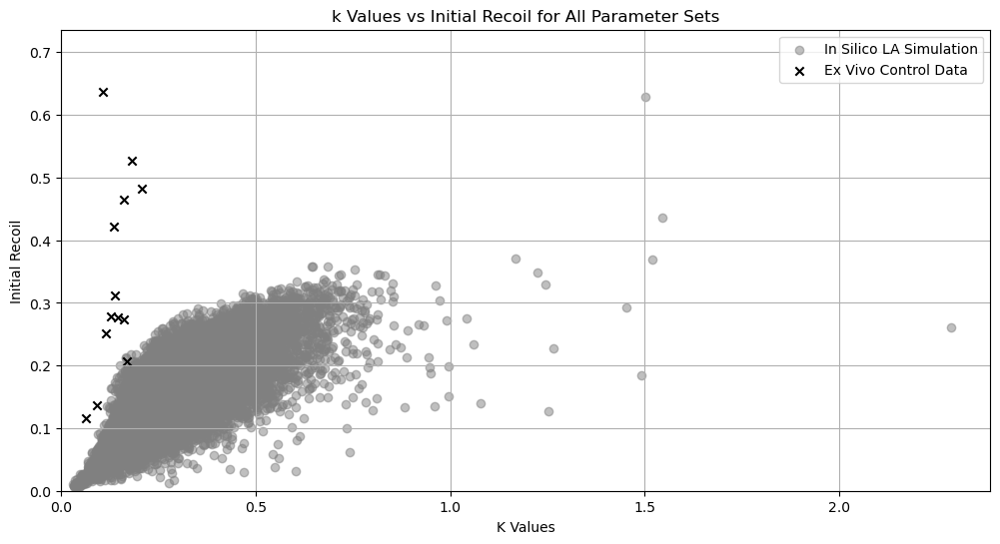

In [31]:
import json
import matplotlib.pyplot as plt
import numpy as np

# Define the path to your JSON file
file_path = 'LE:10-200, AE:10-200, viscosity:400-1500 , 20steps.json'

# Load the JSON data
with open(file_path, 'r') as f:
    data = json.load(f)

# Extract valid and invalid parameters
valid_parameters = data.get('valid_parameters', [])
invalid_parameters = data.get('invalid_parameters', [])

# Define ex vivo data
ex_vivo_initial_recoils = [0.2514, 0.2733, 0.4218, 0.1162, 0.136, 0.6361, 0.5264, 0.465, 0.2762, 0.3121, 0.2776, 0.2073, 0.482]
ex_vivo_k_values = [0.115, 0.1612, 0.1352, 0.06218, 0.09093, 0.1076, 0.1811, 0.1606, 0.1445, 0.1371, 0.1277, 0.1693, 0.2077]

# Plot setup
plt.figure(figsize=(12, 6))

# Variables to track the global max values for axes limits
max_k_value = max(ex_vivo_k_values)
max_initial_recoil_value = max(ex_vivo_initial_recoils)

# Plot invalid parameter combinations in grey circles
for i, param in enumerate(invalid_parameters):
    k_values = param.get('k_values', [])
    initial_recoil_values = param.get('initial_recoil_values', [])
    
    if k_values and initial_recoil_values:
        plt.scatter(k_values, initial_recoil_values, color='grey', alpha=0.5, label='In Silico LA Simulation' if i == 0 else "")
        max_k_value = max(max_k_value, *k_values)
        max_initial_recoil_value = max(max_initial_recoil_value, *initial_recoil_values)

# Plot ex vivo data in grey crosses
plt.scatter(ex_vivo_k_values, ex_vivo_initial_recoils, color='black', alpha=1, marker='x', label='Ex Vivo Control Data')

        
# Plot valid parameter combinations in grey circles (same as invalid)
for i, param in enumerate(valid_parameters):
    k_values = param.get('k_values', [])
    initial_recoil_values = param.get('initial_recoil_values', [])
    
    if k_values and initial_recoil_values:
        plt.scatter(k_values, initial_recoil_values, color='grey', alpha=0.5, label='In Silico LA Simulation' if i == 0 and not invalid_parameters else "")
        max_k_value = max(max_k_value, *k_values)
        max_initial_recoil_value = max(max_initial_recoil_value, *initial_recoil_values)


# Add labels and title
plt.xlabel('K Values')
plt.ylabel('Initial Recoil')
plt.title('k Values vs Initial Recoil for All Parameter Sets')
plt.grid(True)

# Extend axis limits slightly beyond max values
buffer = 0.1  # Add a buffer of 0.1 to the max value
plt.xlim(0, max_k_value + buffer)
plt.ylim(0, max_initial_recoil_value + buffer)

# Add legend
plt.legend(loc='upper right')

# Show the plot
plt.show()


[0.22245878391715296, 1.5452480370299613, 0.5651080162985842, 0.3814529311772251]
[0.1116464175516571, 0.4364555761084704, 0.2014217010227634, 0.13790806016569973]
[0.8530943092651493, 0.7527446180480205, 0.3779751464867817, 0.20191948266321894]
[0.3018248788049404, 0.2754687898177612, 0.20849275323530508, 0.12894389871308]
[0.39861913574918684, 0.932865875292766, 1.1686636243242734, 0.27290478774551596]
[0.19985736451128064, 0.26410547787211286, 0.37021852164219005, 0.13018359975706212]
[0.5484585771934624, 0.6645209069982835, 0.5603020330188615, 1.5029092802789876]
[0.21033314121288435, 0.2273861383191915, 0.2459558235910269, 0.6292268542995995]
[1.520627428051049, 0.21913640937191398, 0.5364611952764375, 0.5359350814768764]
[0.3697843968505337, 0.06796974165135497, 0.23478336051780924, 0.18385712417396585]
[1.2248305525432386, 0.3891352668669979, 0.3703128314482992, 0.3890253206565743]
[0.3486456041379266, 0.14869913520427425, 0.17877936294589725, 0.16581863082666326]
[0.17000765305

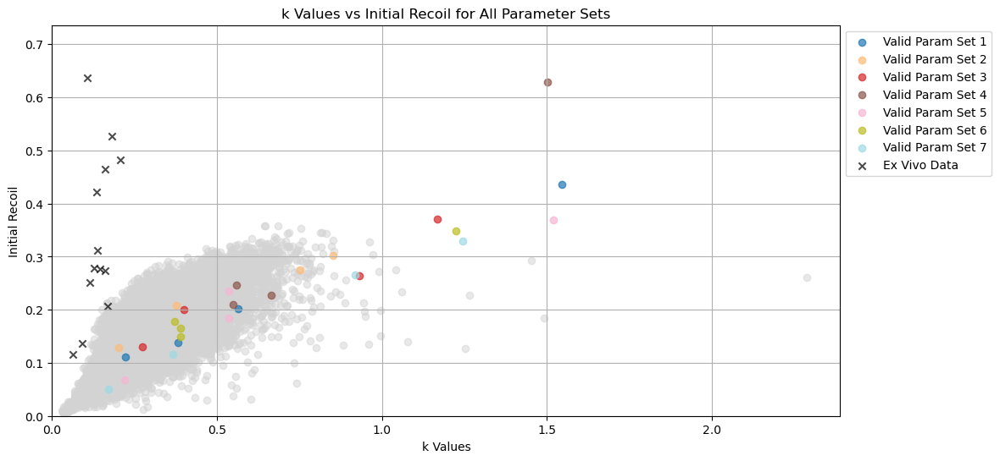

In [21]:
# Define the path to your JSON file
file_path = 'LE:10-200, AE:10-200, viscosity:400-1500 , 20steps.json'

# Load the JSON data
with open(file_path, 'r') as f:
    data = json.load(f)

# Extract valid and invalid parameters
valid_parameters = data.get('valid_parameters', [])
invalid_parameters = data.get('invalid_parameters', [])

# Define ex vivo data
ex_vivo_initial_recoils = [0.2514, 0.2733, 0.4218, 0.1162, 0.136, 0.6361, 0.5264, 0.465, 0.2762, 0.3121, 0.2776, 0.2073, 0.482]
ex_vivo_k_values = [0.115, 0.1612, 0.1352, 0.06218, 0.09093, 0.1076, 0.1811, 0.1606, 0.1445, 0.1371, 0.1277, 0.1693, 0.2077]

# Plot setup
plt.figure(figsize=(12, 6))

# Define a colormap for valid parameters
colors = plt.cm.get_cmap('tab20', len(valid_parameters))

# Variables to track the global max values for axes limits
max_k_value = max(ex_vivo_k_values)
max_initial_recoil_value = max(ex_vivo_initial_recoils)

# Plot each invalid parameter combination in light grey
for i, param in enumerate(invalid_parameters):
    k_values = param.get('k_values', [])
    initial_recoil_values = param.get('initial_recoil_values', [])
    
    if k_values and initial_recoil_values:
        plt.scatter(k_values, initial_recoil_values, color='lightgrey', alpha=0.5)
        max_k_value = max(max_k_value, *k_values)
        max_initial_recoil_value = max(max_initial_recoil_value, *initial_recoil_values)

# Plot each valid parameter combination
for i, param in enumerate(valid_parameters):
    k_values = param.get('k_values', [])
    initial_recoil_values = param.get('initial_recoil_values', [])
    
    if k_values and initial_recoil_values:
        plt.scatter(k_values, initial_recoil_values, color=colors(i), label=f'Valid Param Set {i + 1}', alpha=0.7)
        max_k_value = max(max_k_value, *k_values)
        max_initial_recoil_value = max(max_initial_recoil_value, *initial_recoil_values)
        print(k_values)
        print(initial_recoil_values)

# Plot ex_vivo data
plt.scatter(ex_vivo_k_values, ex_vivo_initial_recoils, color='black', label='Ex Vivo Data', alpha=0.7, marker='x')

# Add labels and title
plt.xlabel('k Values')
plt.ylabel('Initial Recoil')
plt.title('k Values vs Initial Recoil for All Parameter Sets')
plt.legend(loc='upper right', bbox_to_anchor=(1.2, 1))
plt.grid(True)

# Extend axis limits slightly beyond max values
buffer = 0.1  # Add a buffer of 0.1 to the max value
plt.xlim(0, max_k_value + buffer)
plt.ylim(0, max_initial_recoil_value + buffer)

# Show the plot
plt.show()


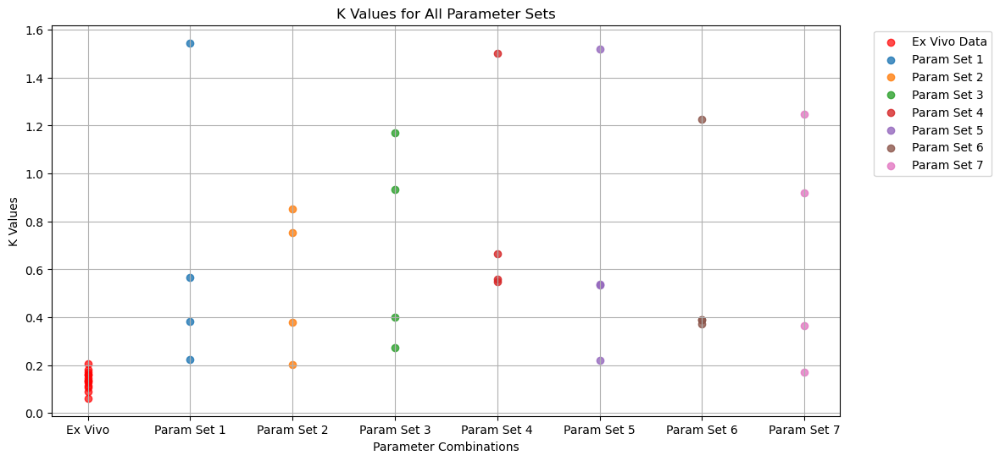

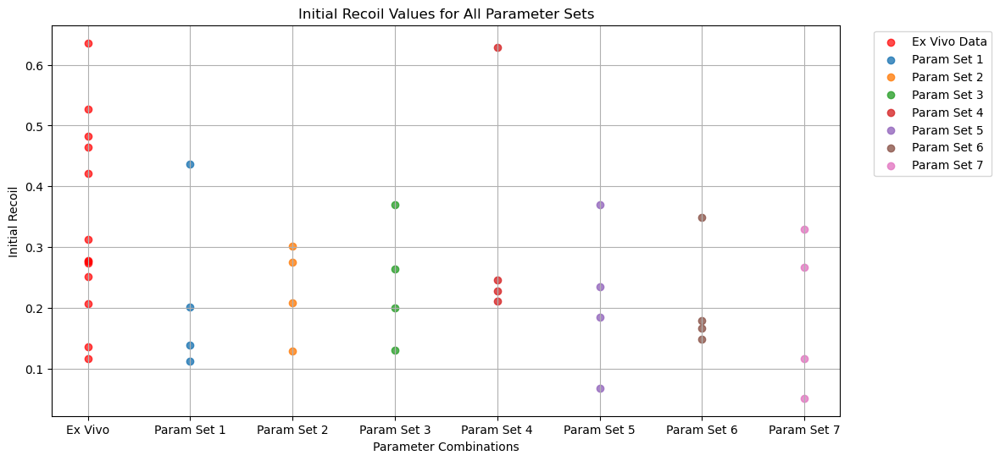

In [33]:
import json
import matplotlib.pyplot as plt

# Define the path to your JSON file
file_path = 'LE:10-200, AE:10-200, viscosity:400-1500 , 20steps.json'

# Load the JSON data
with open(file_path, 'r') as f:
    data = json.load(f)

# Extract valid and invalid parameters
valid_parameters = data.get('valid_parameters', [])
invalid_parameters = data.get('invalid_parameters', [])

# Define ex_vivo data
ex_vivo_initial_recoils = [0.2514, 0.2733, 0.4218, 0.1162, 0.136, 0.6361, 0.5264, 0.465, 0.2762, 0.3121, 0.2776, 0.2073, 0.482]
ex_vivo_k_values = [0.115, 0.1612, 0.1352, 0.06218, 0.09093, 0.1076, 0.1811, 0.1606, 0.1445, 0.1371, 0.1277, 0.1693, 0.2077]

# Plot setup for k-values
plt.figure(figsize=(12, 6))

# Plot ex vivo data for k-values first
plt.scatter(['Ex Vivo'] * len(ex_vivo_k_values), ex_vivo_k_values, color='red', label='Ex Vivo Data', alpha=0.7, marker='o')

# Plot each valid parameter combination for k-values
for i, param in enumerate(valid_parameters):
    k_values = param.get('k_values', [])
    plt.scatter([f'Param Set {i + 1}'] * len(k_values), k_values, label=f'Param Set {i + 1}', alpha=0.8)

# Add labels and title
plt.xlabel('Parameter Combinations')
plt.ylabel('K Values')
plt.title('K Values for All Parameter Sets')
plt.legend(loc='upper right', bbox_to_anchor=(1.2, 1))
plt.grid(True)

# Show the plot
plt.show()

# Plot setup for initial recoil values
plt.figure(figsize=(12, 6))

# Plot ex vivo data for initial recoil values first
plt.scatter(['Ex Vivo'] * len(ex_vivo_initial_recoils), ex_vivo_initial_recoils, color='red', label='Ex Vivo Data', alpha=0.7, marker='o')

# Plot each valid parameter combination for initial recoil values
for i, param in enumerate(valid_parameters):
    initial_recoil_values = param.get('initial_recoil_values', [])
    plt.scatter([f'Param Set {i + 1}'] * len(initial_recoil_values), initial_recoil_values, label=f'Param Set {i + 1}', alpha=0.8)

# Add labels and title
plt.xlabel('Parameter Combinations')
plt.ylabel('Initial Recoil')
plt.title('Initial Recoil Values for All Parameter Sets')
plt.legend(loc='upper right', bbox_to_anchor=(1.2, 1))
plt.grid(True)

# Show the plot
plt.show()


In [ ]:
import json
import numpy as np
from scipy.spatial.distance import mahalanobis

# Define the path to your JSON file
file_path = 'LE:10-200, AE:10-200, viscosity:400-1500 , 20steps.json'

# Load the JSON data
with open(file_path, 'r') as f:
    data = json.load(f)

# Extract the 'initial_recoil_values' and 'k_values' from JSON data
valid_parameters = data['valid_parameters']

# Create a matrix with k_values and initial_recoil_values
json_matrix = []
for param in valid_parameters:
    combined_values = param["k_values"] + param["initial_recoil_values"]
    json_matrix.append(combined_values)

json_matrix = np.array(json_matrix)

# Calculate the mean and covariance matrix for the JSON data
mean_vector = np.mean(json_matrix, axis=0)
covariance_matrix = np.cov(json_matrix, rowvar=False)

# Invert the covariance matrix
inv_covariance_matrix = np.linalg.inv(covariance_matrix)

# Use only the first 4 k_values and 4 initial_recoils from ex vivo data for comparison
ex_vivo_values = ex_vivo_k_values[:4] + ex_vivo_initial_recoils[:4]
ex_vivo_values = np.array(ex_vivo_values)

# Calculate the Mahalanobis distance
distance = mahalanobis(ex_vivo_values, mean_vector, inv_covariance_matrix)

print(f"Mahalanobis Distance: {distance}")


### Scatter plot according to Mahalanobis analysis

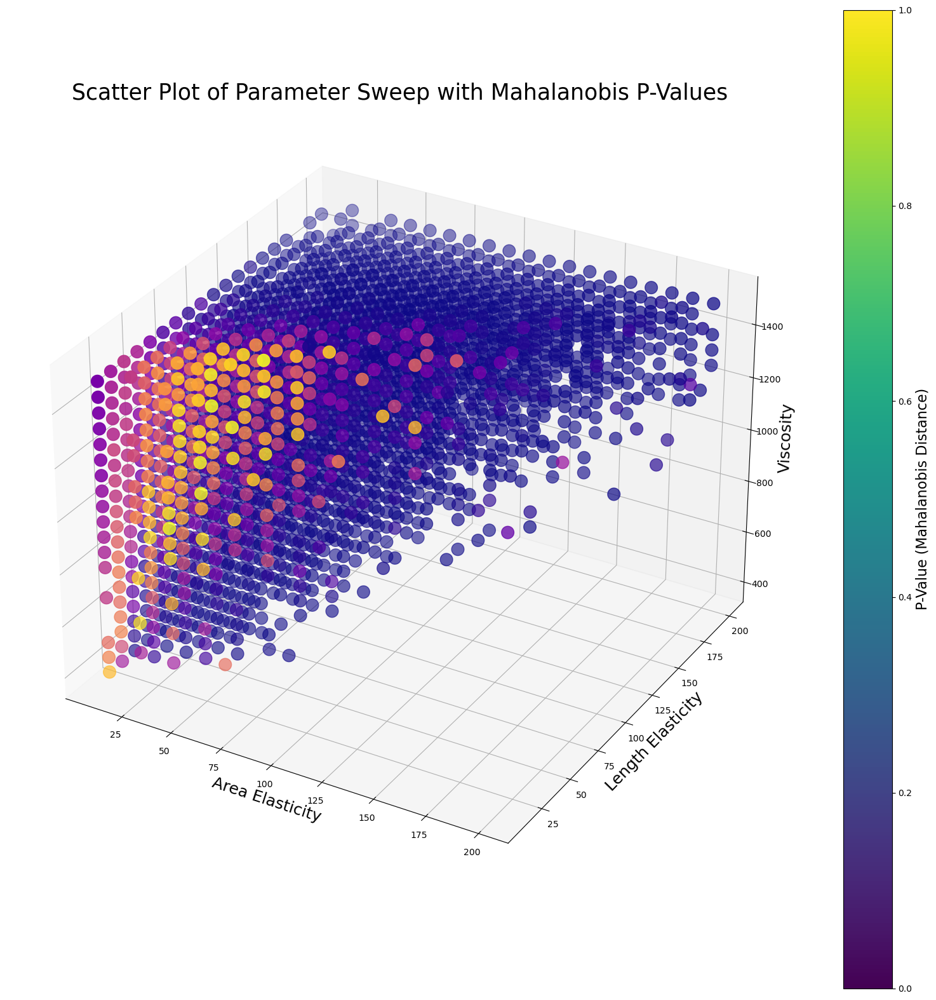

In [34]:
import json
import numpy as np
import matplotlib.pyplot as plt
from scipy.spatial.distance import mahalanobis
from scipy.stats import chi2
from mpl_toolkits.mplot3d import Axes3D
from matplotlib import cm

# Load the JSON data
with open('LE:10-200, AE:10-200, viscosity:400-1500 , 20steps.json') as f:
    data = json.load(f)

# Ex vivo values
ex_vivo_k_values = [0.115, 0.1612, 0.1352, 0.06218, 0.09093, 0.1076, 0.18110, 0.1817, 0.14450, 0.1371, 0.1277, 0.1693, 0.2077]
ex_vivo_initial_recoils = [0.02095, 0.02398, 0.04687, 0.009687, 0.009067, 0.07311, 0.06121, 0.03456, 0.02192, 0.02439, 0.01595, 0.02591, 0.06101]

# Combine ex vivo data
ex_vivo_data = np.array([ex_vivo_k_values, ex_vivo_initial_recoils]).T

# Calculate the mean vector and covariance matrix from ex vivo data
mean_vector = np.mean(ex_vivo_data, axis=0)
covariance_matrix = np.cov(ex_vivo_data, rowvar=False)

# Regularization term
epsilon = 1e-5
regularized_cov_matrix = covariance_matrix + epsilon * np.eye(covariance_matrix.shape[0])

# Invert the covariance matrix
inv_cov_matrix = np.linalg.inv(regularized_cov_matrix)

# Extract parameters from the dataset
all_parameters = data['valid_parameters'] + data['invalid_parameters']

# Initialize lists for area elasticity, length elasticity, viscosity, and p-values
area_elasticity = []
length_elasticity = []
viscosity = []
p_values = []

# Calculate Mahalanobis distances and p-values for each parameter combination
for param in all_parameters:
    if "k_values" in param and "initial_recoil_values" in param:
        k_values = param["k_values"][:13]
        initial_recoil_values = param["initial_recoil_values"][:13]
        distances = []
        for k_value, initial_recoil_value in zip(k_values, initial_recoil_values):
            # Create the 2D point vector
            point = np.array([k_value, initial_recoil_value])
            # Calculate Mahalanobis distance
            distance = mahalanobis(point, mean_vector, inv_cov_matrix)
            distances.append(distance)
        
        # Sum the distances for the combo and calculate p-value
        sum_of_distances = np.sum(distances)
        p_value = 1 - chi2.cdf(sum_of_distances, df=2 * len(distances))  # df is 2 for 2D points
        p_values.append(p_value)
        
        # Store the parameter values
        area_elasticity.append(param["area_elasticity"])
        length_elasticity.append(param["length_elasticity"])
        viscosity.append(param["viscosity"])

# Create a color map based on the p-values
cmap = cm.get_cmap('plasma')
norm = plt.Normalize(vmin=min(p_values), vmax=max(p_values))
colors = cmap(norm(p_values))

# Plot the 3D scatter plot with color based on p-values
fig = plt.figure(figsize=(20, 20))
ax = fig.add_subplot(111, projection='3d')

# Scatter plot with color based on p-values
sc = ax.scatter(area_elasticity, length_elasticity, viscosity, c=colors, marker='o', s=200)

# Set axis labels
ax.set_xlabel('Area Elasticity', fontsize=18)
ax.set_ylabel('Length Elasticity', fontsize=18)
ax.set_zlabel('Viscosity', fontsize=18)
ax.set_title('Scatter Plot of Parameter Sweep with Mahalanobis P-Values', fontsize=25)

# Add a color bar to represent the p-values
cbar = plt.colorbar(sc, ax=ax)
cbar.set_label('P-Value (Mahalanobis Distance)', fontsize=16)

plt.show()
